In [1]:
import pandas as pd
import seaborn as sns
import datetime as dt
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from tensorflow.keras.layers import LSTM
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_squared_error
from dateutil.parser import parse 
import statsmodels.tsa.seasonal as sm
from pmdarima import auto_arima
from sklearn.model_selection import train_test_split

### Load Data

In [2]:
df_afrr = pd.read_csv("afrr_data1.csv", sep=';')

In [3]:
df_afrr.head()

,Date,Time of day,Volume activated (+)[MWh],Volume activated (-)[MWh],Activation price (+)[€/MWh],Activation price (-)[€/MWh],Volume procured (+)[MW],Volume procured (-)[MW],Procurement price (+)[€/MW],Procurement price (-)[€/MW]
0,"Sep 14, 2021",12:00 AM,61,1,239.9,-64.01,"1,929","1,942",0.75,0.76
1,"Sep 14, 2021",12:15 AM,54,3,235.93,-63.59,"1,929","1,942",0.75,0.76
2,"Sep 14, 2021",12:30 AM,17,2,206.29,-63.76,"1,929","1,942",0.75,0.76
3,"Sep 14, 2021",12:45 AM,6,15,171.97,-63.13,"1,929","1,942",0.75,0.76
4,"Sep 14, 2021",1:00 AM,17,6,205.35,-63.32,"1,929","1,942",0.75,0.76


### Rename Column Names

In [4]:
df = df_afrr.iloc[:,0:4]
df = df.rename(columns={"Time of day": "Time", "Volume activated (+)[MWh]":"Positive", "Volume activated (-)[MWh]":"Negative"})
df.head()

,Date,Time,Positive,Negative
0,"Sep 14, 2021",12:00 AM,61,1
1,"Sep 14, 2021",12:15 AM,54,3
2,"Sep 14, 2021",12:30 AM,17,2
3,"Sep 14, 2021",12:45 AM,6,15
4,"Sep 14, 2021",1:00 AM,17,6


### Fix Data Formats

In [5]:
df["DateTime"] = df["Date"] + " "+ df["Time"]

In [6]:
df['DateTime'] =  pd.to_datetime(df['DateTime'])
dataType = df.dtypes
print(dataType)

df = df.drop(['Date', 'Time'], axis = 1)
df.insert(0,"DateTime",df.pop('DateTime'))

Date                object
Time                object
Positive             int64
Negative             int64
DateTime    datetime64[ns]
dtype: object


In [7]:
df.head()

,DateTime,Positive,Negative
0,2021-09-14 00:00:00,61,1
1,2021-09-14 00:15:00,54,3
2,2021-09-14 00:30:00,17,2
3,2021-09-14 00:45:00,6,15
4,2021-09-14 01:00:00,17,6


In [8]:
df['Positive'] = pd.to_numeric(df['Positive'])
df['Negative'] = pd.to_numeric(df['Negative'])

In [9]:
df

,DateTime,Positive,Negative
0,2021-09-14 00:00:00,61,1
1,2021-09-14 00:15:00,54,3
2,2021-09-14 00:30:00,17,2
3,2021-09-14 00:45:00,6,15
4,2021-09-14 01:00:00,17,6
...,...,...,...
35131,2022-09-14 22:45:00,13,1
35132,2022-09-14 23:00:00,9,1
35133,2022-09-14 23:15:00,15,8
35134,2022-09-14 23:30:00,0,93


### Describe Data

In [10]:
df_pos = df[['DateTime','Positive']].copy()
df_neg = df[['DateTime','Negative']].copy()

In [11]:
df_pos.describe()

,Positive
count,35136.000000
mean,25.876281
std,45.186696
min,0.000000
25%,1.000000
50%,5.000000
75%,31.000000
max,460.000000


In [12]:
df_neg.describe()

,Negative
count,35136.000000
mean,25.650074
std,44.515024
min,0.000000
25%,1.000000
50%,5.000000
75%,30.000000
max,483.000000


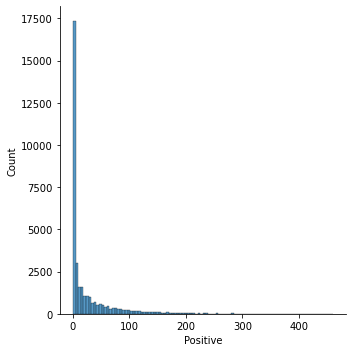

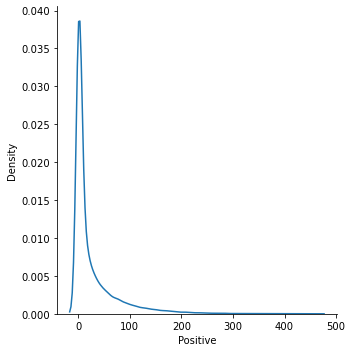

In [13]:
# mpl.rcParams.update(mpl.rcParamsDefault)
sns.displot(df_pos, x="Positive", bins = 100)
sns.displot(df_pos, x="Positive", kind="kde")
plt.show()

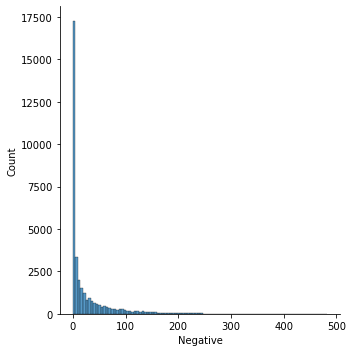

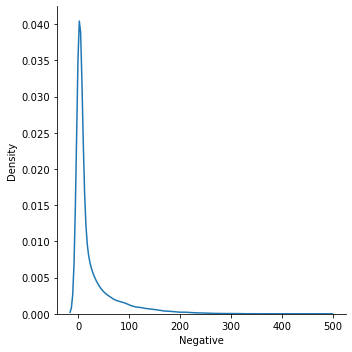

In [14]:
sns.displot(df_neg, x="Negative", bins = 100)
sns.displot(df_neg, x="Negative", kind="kde")
plt.show()

### Time Series Plot

In [15]:
df_pos.set_index('DateTime', inplace = True)
df_neg.set_index('DateTime', inplace = True)

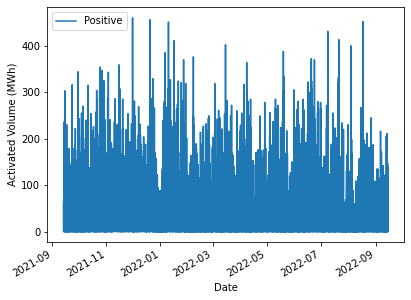

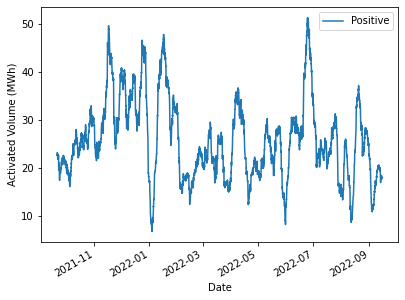

In [16]:
df_posmean = df_pos.rolling(window = 7*24*4).mean()
plt.rcParams["figure.figsize"] = (6.4, 4.8)
plt.rcParams.update({'font.size': 10})
df_pos.plot(xlabel="Date", ylabel="Activated Volume (MWh)")
# average per week
df_posmean.plot(xlabel="Date", ylabel="Activated Volume (MWh)")
plt.show()

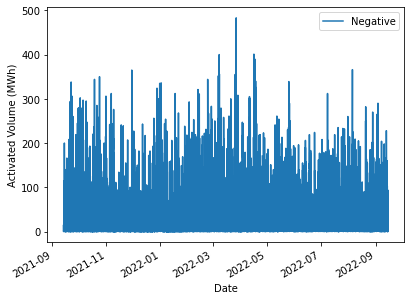

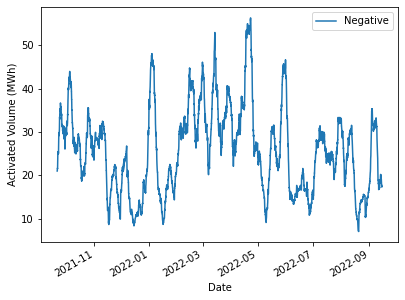

In [17]:
df_negmean = df_neg.rolling(window = 7*24*4).mean()
df_neg.plot(xlabel="Date", ylabel="Activated Volume (MWh)")
df_negmean.plot(xlabel="Date", ylabel="Activated Volume (MWh)")
plt.show()

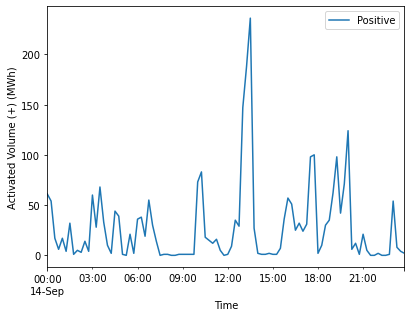

In [18]:
df_pos.iloc[0:96].plot(xlabel="Time", ylabel="Activated Volume (+) (MWh)")
plt.show()

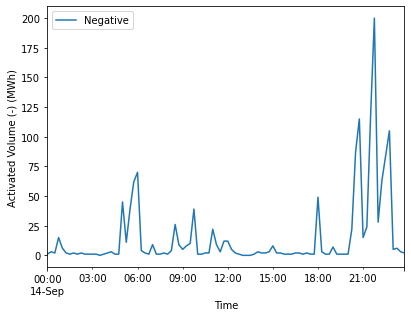

In [19]:
df_neg.iloc[0:96].plot(xlabel="Time", ylabel="Activated Volume (-) (MWh)")
plt.show()

# Heatmap

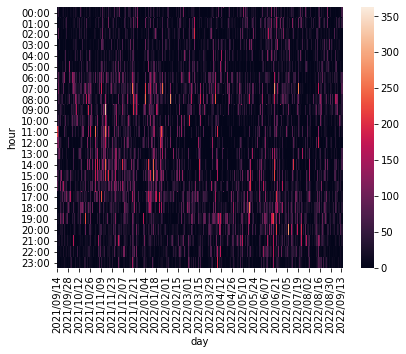

In [20]:
sns.heatmap(df.groupby([df.DateTime.dt.strftime('%Y/%m/%d'), df.DateTime.dt.strftime('%H:00')])
   ['Positive'].mean()
   .rename_axis(index=['day','hour'])
   .unstack(level=0)
)
plt.show()

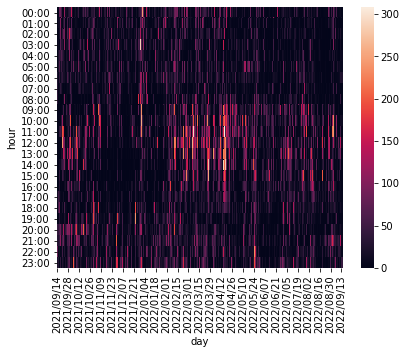

In [21]:
sns.heatmap(df.groupby([df.DateTime.dt.strftime('%Y/%m/%d'), df.DateTime.dt.strftime('%H:00')])
   ['Negative'].mean()
   .rename_axis(index=['day','hour'])
   .unstack(level=0)
)
plt.show()

### New data frame for 15min increments

In [22]:
df_15min = pd.DataFrame()

df_15min = df.copy()
df_15min["PosDiff"] = df["Positive"].diff()
df_15min["NegDiff"] = df["Negative"].diff()
df_15min['hr_min'] = [d.strftime('%H%M') for d in df_15min.DateTime]
df_15min.head(10)

,DateTime,Positive,Negative,PosDiff,NegDiff,hr_min
0,2021-09-14 00:00:00,61,1,NaN,NaN,0000
1,2021-09-14 00:15:00,54,3,-7.0,2.0,0015
2,2021-09-14 00:30:00,17,2,-37.0,-1.0,0030
3,2021-09-14 00:45:00,6,15,-11.0,13.0,0045
4,2021-09-14 01:00:00,17,6,11.0,-9.0,0100
5,2021-09-14 01:15:00,4,2,-13.0,-4.0,0115
6,2021-09-14 01:30:00,32,1,28.0,-1.0,0130
7,2021-09-14 01:45:00,1,2,-31.0,1.0,0145
8,2021-09-14 02:00:00,5,1,4.0,-1.0,0200
9,2021-09-14 02:15:00,3,2,-2.0,1.0,0215


In [23]:
df_15min.set_index('DateTime', inplace = True)

In [24]:
df_15min.describe()

,Positive,Negative,PosDiff,NegDiff
count,35136.000000,35136.000000,35135.000000,35135.000000
mean,25.876281,25.650074,-0.001736,0.002078
std,45.186696,44.515024,36.549242,35.136828
min,0.000000,0.000000,-424.000000,-312.000000
25%,1.000000,1.000000,-7.000000,-5.000000
50%,5.000000,5.000000,0.000000,0.000000
75%,31.000000,30.000000,6.000000,6.000000
max,460.000000,483.000000,316.000000,306.000000


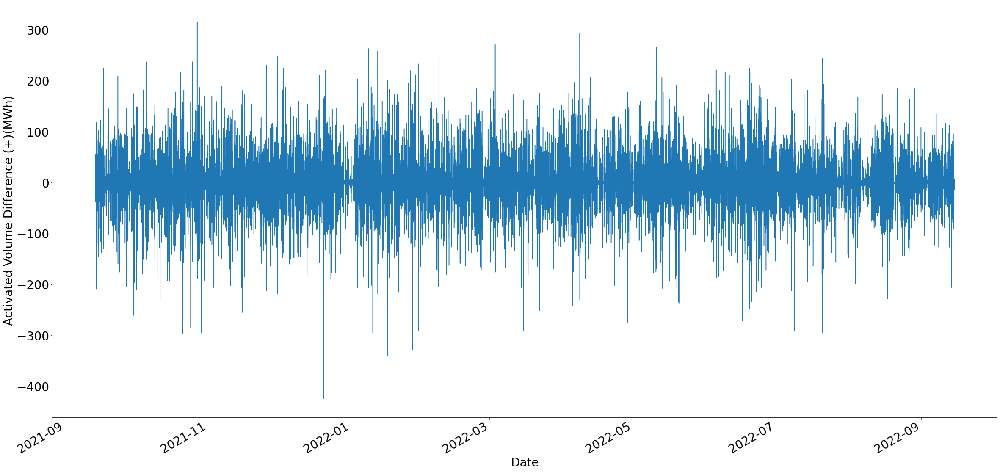

In [25]:
plt.rcParams["figure.figsize"] = (40,20)
plt.rcParams.update({'font.size': 28})
df_15min["PosDiff"].plot(xlabel="Date", ylabel="Activated Volume Difference (+)(MWh)")
plt.show()

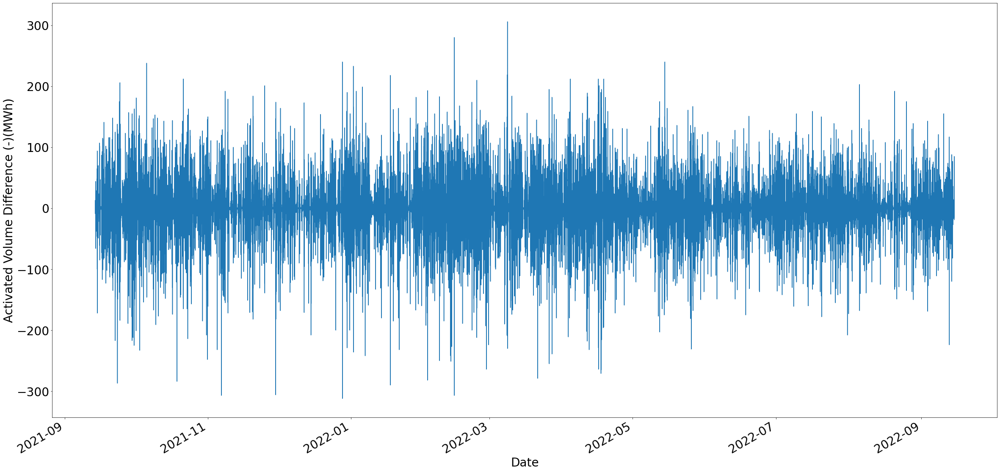

In [26]:
plt.rcParams["figure.figsize"] = (40,20)
df_15min["NegDiff"].plot(xlabel="Date", ylabel="Activated Volume Difference (-)(MWh)")
plt.show()

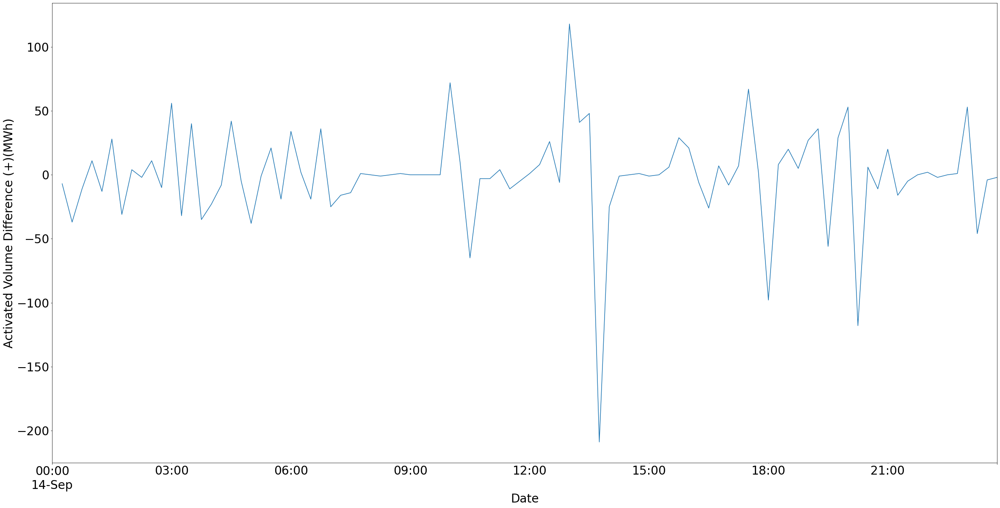

In [27]:
plt.rcParams["figure.figsize"] = (40,20)
df_15min["PosDiff"].iloc[0:96].plot(xlabel="Date", ylabel="Activated Volume Difference (+)(MWh)")
plt.show()

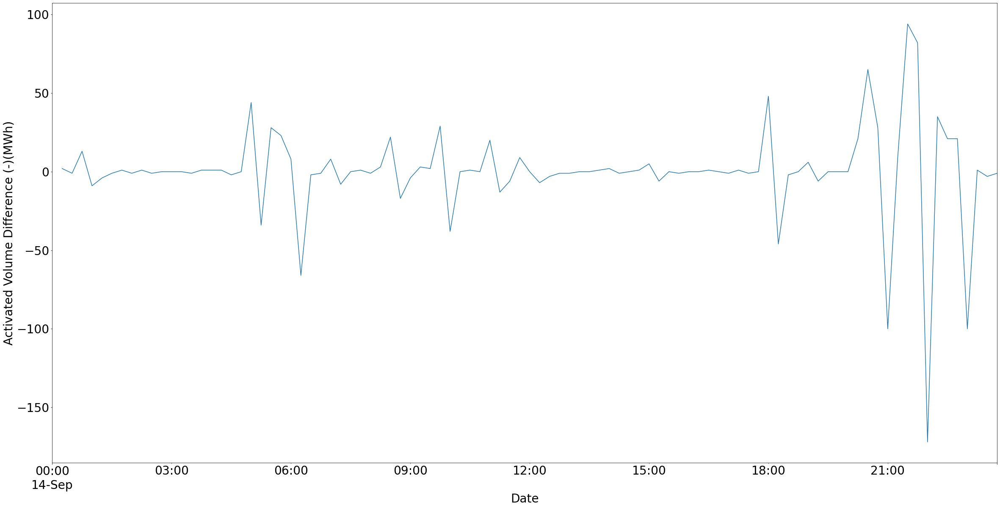

In [28]:
plt.rcParams["figure.figsize"] = (40,20)
df_15min["NegDiff"].iloc[0:96].plot(xlabel="Date", ylabel="Activated Volume Difference (-)(MWh)")
plt.show()

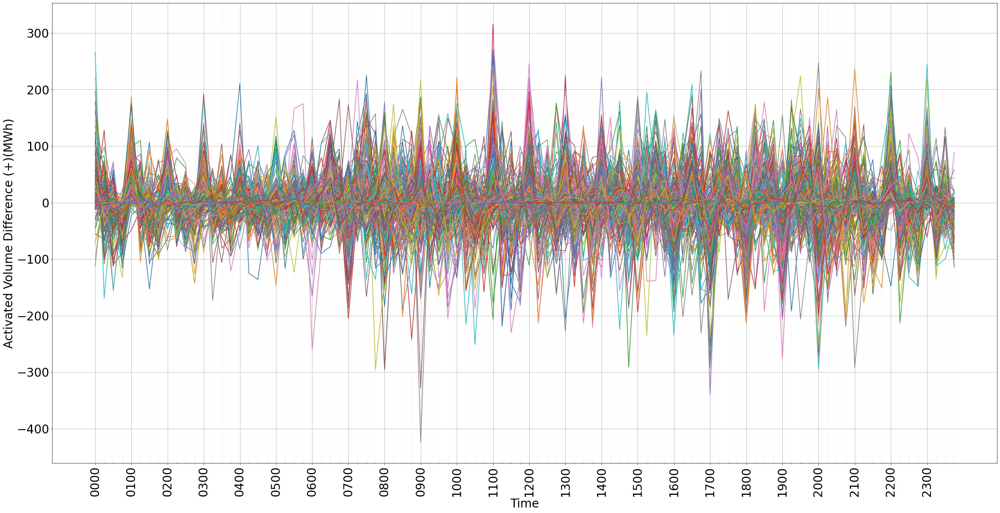

In [29]:
fig = plt.figure()
ax = fig.add_subplot(1, 1, 1)

plt.rcParams["figure.figsize"] = (50,18)
plt.rcParams.update({'font.size': 28})

i=0
for x in range(int(len(df_15min)/96)):
    plt.plot(df_15min["hr_min"].iloc[:96],df_15min["PosDiff"].iloc[i:i+96])
    i+=96
    
ax.set_xticks(df_15min["hr_min"].iloc[:96:4])
ax.set_xticks(df_15min["hr_min"].iloc[:96], minor = True)
    
plt.xticks(rotation=90)
plt.xlabel("Time")
plt.ylabel("Activated Volume Difference (+)(MWh)")
ax.grid(which='major', alpha=1)
ax.grid(which='minor', alpha=0.1)
plt.show()

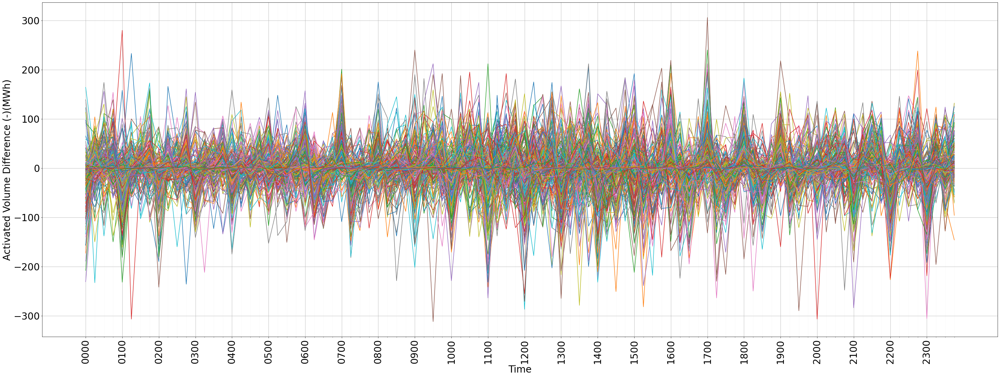

In [30]:
fig = plt.figure()
ax = fig.add_subplot(1, 1, 1)

plt.rcParams["figure.figsize"] = (50,18)
plt.rcParams.update({'font.size': 28})

i=0
for x in range(int(len(df_15min)/96)):
    plt.plot(df_15min["hr_min"].iloc[:96],df_15min["NegDiff"].iloc[i:i+96])
    i+=96
    
ax.set_xticks(df_15min["hr_min"].iloc[:96:4])
ax.set_xticks(df_15min["hr_min"].iloc[:96], minor = True)
    
plt.xticks(rotation=90)
plt.xlabel("Time")
plt.ylabel("Activated Volume Difference (-)(MWh)")
ax.grid(which='major', alpha=1)
ax.grid(which='minor', alpha=0.1)
plt.show()

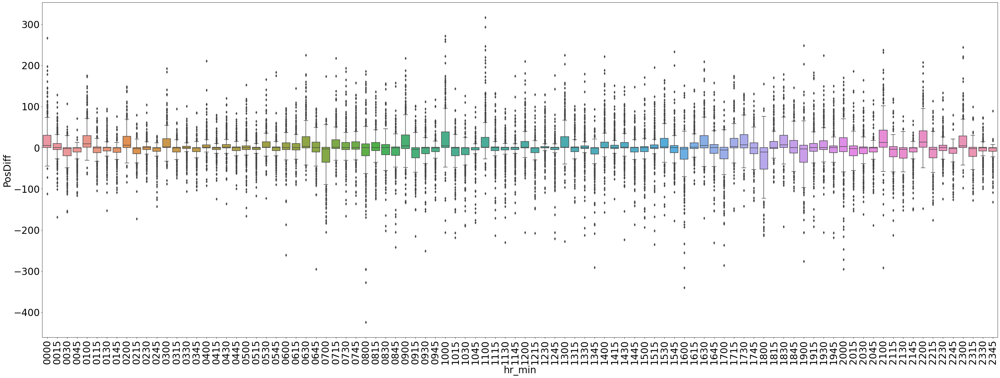

In [31]:
fig, ax = plt.subplots()
plt.xticks(rotation=90)
ax.yaxis.grid(False) # Hide the horizontal gridlines
ax.xaxis.grid(True) # Show the vertical gridlines
sns.boxplot(x='hr_min', y='PosDiff', data=df_15min)
plt.show()

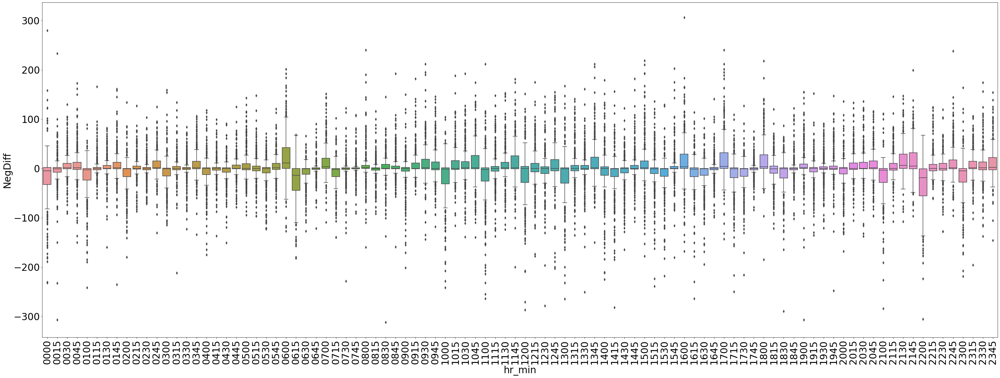

In [32]:
plt.xticks(rotation=90)
sns.boxplot(x='hr_min', y='NegDiff', data=df_15min)
plt.show()

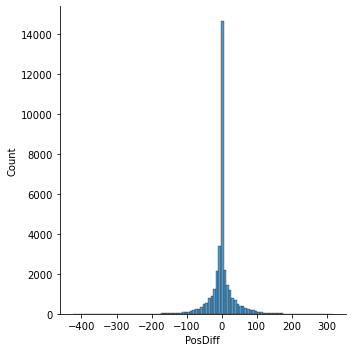

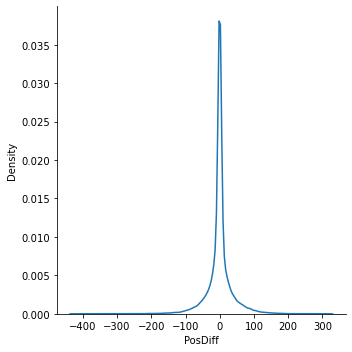

In [33]:
plt.rcParams.update({'font.size': 10})
sns.displot(df_15min, x="PosDiff", bins = 100)
sns.displot(df_15min, x="PosDiff", kind="kde")
plt.show()

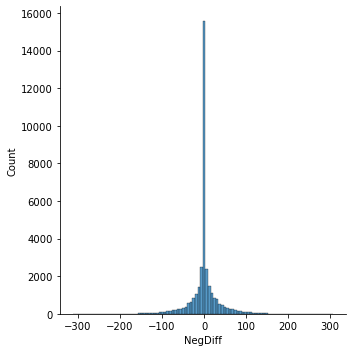

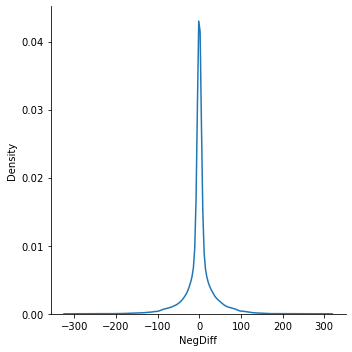

In [34]:
sns.displot(df_15min, x="NegDiff", bins = 100)
sns.displot(df_15min, x="NegDiff", kind="kde")
plt.show()

### New data frame for 30min increments

In [35]:
df_30min = pd.DataFrame()

df_30min = df.copy()
df_30min["PosDiff"] = df["Positive"].diff(periods = 2)
df_30min["NegDiff"] = df["Negative"].diff(periods = 2)
df_30min['hr_min'] = [d.strftime('%H%M') for d in df_30min.DateTime]
df_30min.head(10)

,DateTime,Positive,Negative,PosDiff,NegDiff,hr_min
0,2021-09-14 00:00:00,61,1,NaN,NaN,0000
1,2021-09-14 00:15:00,54,3,NaN,NaN,0015
2,2021-09-14 00:30:00,17,2,-44.0,1.0,0030
3,2021-09-14 00:45:00,6,15,-48.0,12.0,0045
4,2021-09-14 01:00:00,17,6,0.0,4.0,0100
5,2021-09-14 01:15:00,4,2,-2.0,-13.0,0115
6,2021-09-14 01:30:00,32,1,15.0,-5.0,0130
7,2021-09-14 01:45:00,1,2,-3.0,0.0,0145
8,2021-09-14 02:00:00,5,1,-27.0,0.0,0200
9,2021-09-14 02:15:00,3,2,2.0,0.0,0215


In [36]:
df_30min.set_index('DateTime', inplace = True)

In [37]:
df_30min.describe()

,Positive,Negative,PosDiff,NegDiff
count,35136.000000,35136.000000,35134.000000,35134.000000
mean,25.876281,25.650074,-0.003273,0.004639
std,45.186696,44.515024,47.828241,45.244214
min,0.000000,0.000000,-431.000000,-361.000000
25%,1.000000,1.000000,-10.000000,-8.000000
50%,5.000000,5.000000,0.000000,0.000000
75%,31.000000,30.000000,10.000000,9.000000
max,460.000000,483.000000,361.000000,347.000000


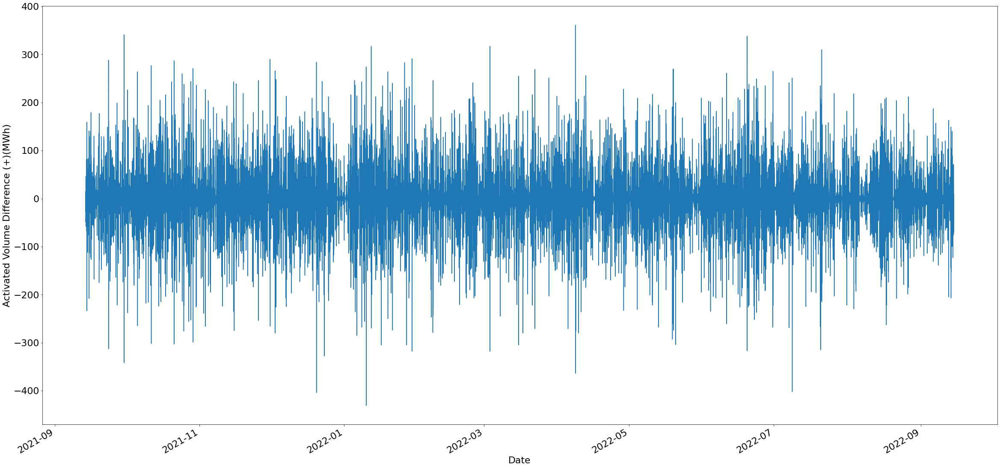

In [38]:
plt.rcParams["figure.figsize"] = (40,20)
plt.rcParams.update({'font.size': 22})
df_30min["PosDiff"].plot(xlabel="Date", ylabel="Activated Volume Difference (+)(MWh)")
plt.show()

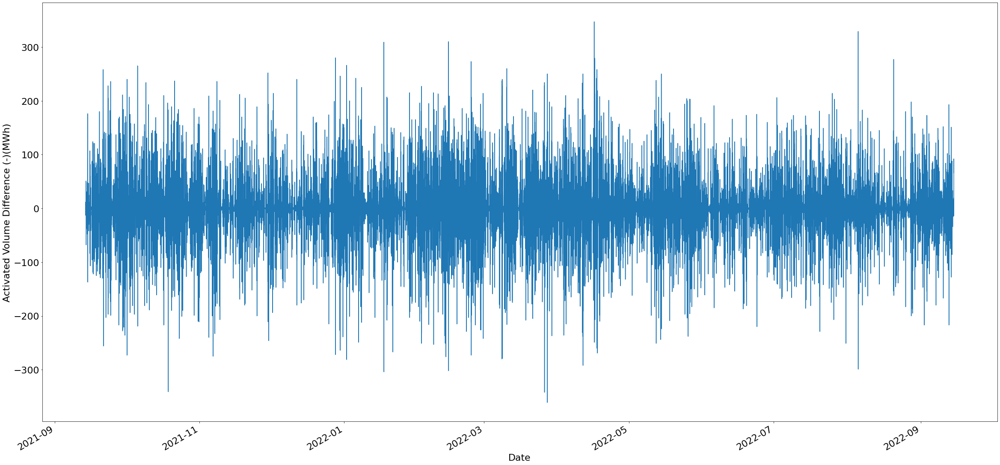

In [39]:
plt.rcParams["figure.figsize"] = (40,20)
df_30min["NegDiff"].plot(xlabel="Date", ylabel="Activated Volume Difference (-)(MWh)")
plt.show()

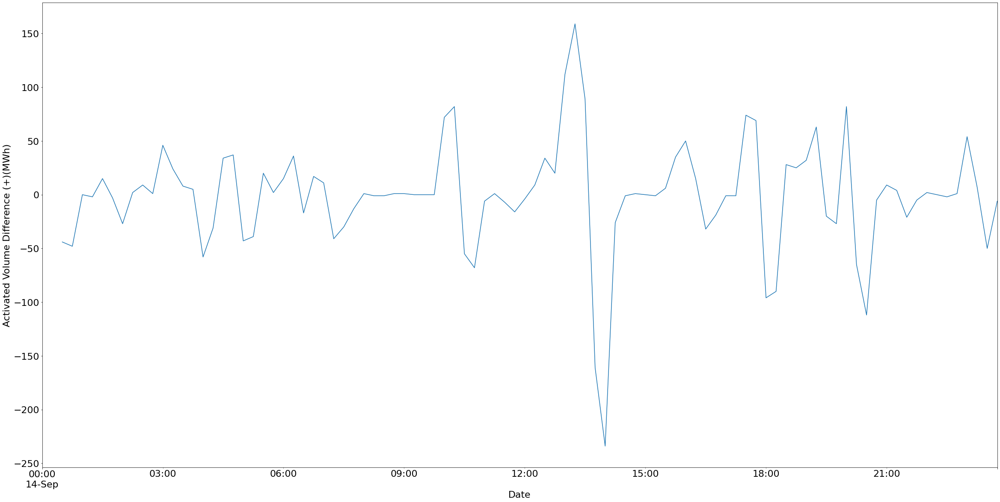

In [40]:
plt.rcParams["figure.figsize"] = (40,20)
plt.rcParams.update({'font.size': 22})
df_30min["PosDiff"].iloc[0:96].plot(xlabel="Date", ylabel="Activated Volume Difference (+)(MWh)")
plt.show()

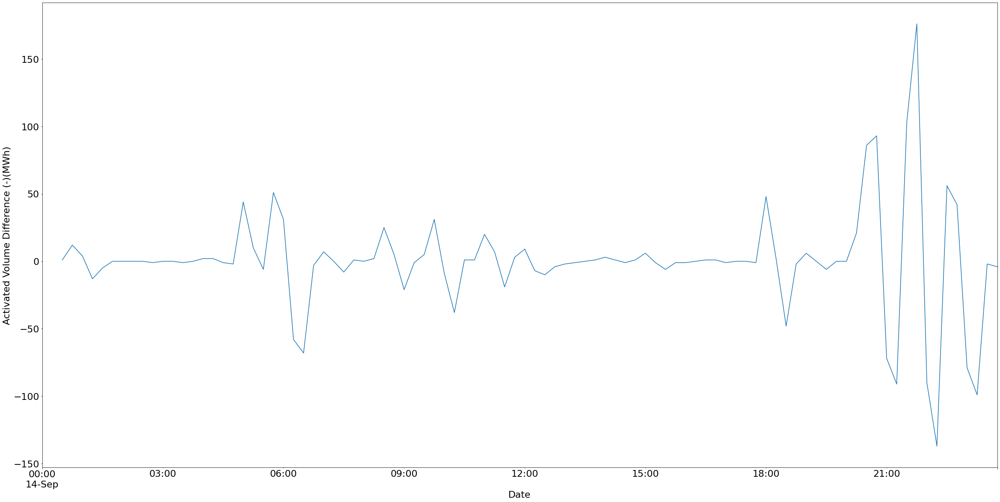

In [41]:
plt.rcParams["figure.figsize"] = (40,20)
df_30min["NegDiff"].iloc[0:96].plot(xlabel="Date", ylabel="Activated Volume Difference (-)(MWh)")
plt.show()

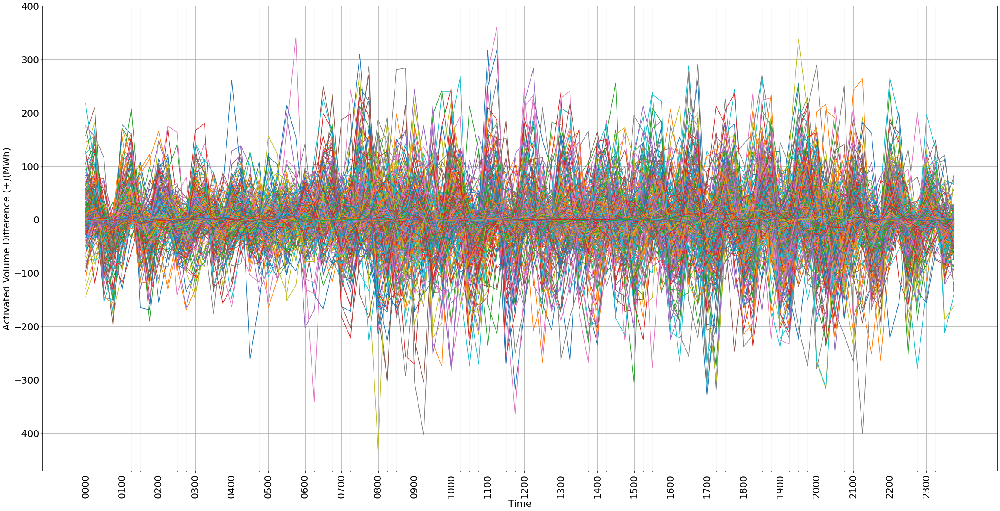

In [42]:
fig = plt.figure()
ax = fig.add_subplot(1, 1, 1)

plt.rcParams["figure.figsize"] = (50,18)
plt.rcParams.update({'font.size': 28})

i=0
for x in range(int(len(df_30min)/96)):
    plt.plot(df_30min["hr_min"].iloc[:96],df_30min["PosDiff"].iloc[i:i+96])
    i+=96
    
ax.set_xticks(df_30min["hr_min"].iloc[:96:4])
ax.set_xticks(df_30min["hr_min"].iloc[:96], minor = True)
    
plt.xticks(rotation=90)
plt.xlabel("Time")
plt.ylabel("Activated Volume Difference (+)(MWh)")
ax.grid(which='major', alpha=1)
ax.grid(which='minor', alpha=0.1)
plt.show()

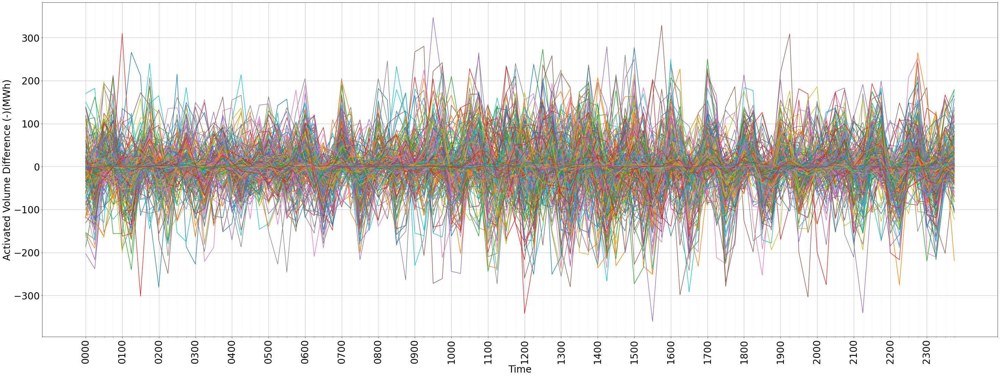

In [43]:
fig = plt.figure()
ax = fig.add_subplot(1, 1, 1)

plt.rcParams["figure.figsize"] = (50,18)
plt.rcParams.update({'font.size': 28})

i=0
for x in range(int(len(df_30min)/96)):
    plt.plot(df_30min["hr_min"].iloc[:96],df_30min["NegDiff"].iloc[i:i+96])
    i+=96
    
ax.set_xticks(df_30min["hr_min"].iloc[:96:4])
ax.set_xticks(df_30min["hr_min"].iloc[:96], minor = True)
    
plt.xticks(rotation=90)
plt.xlabel("Time")
plt.ylabel("Activated Volume Difference (-)(MWh)")
ax.grid(which='major', alpha=1)
ax.grid(which='minor', alpha=0.1)
plt.show()

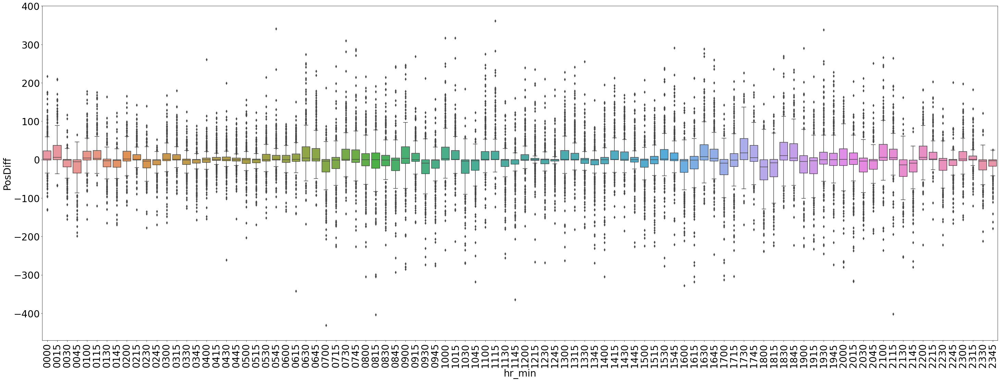

In [44]:
plt.xticks(rotation=90)
sns.boxplot(x='hr_min', y='PosDiff', data=df_30min)
plt.show()

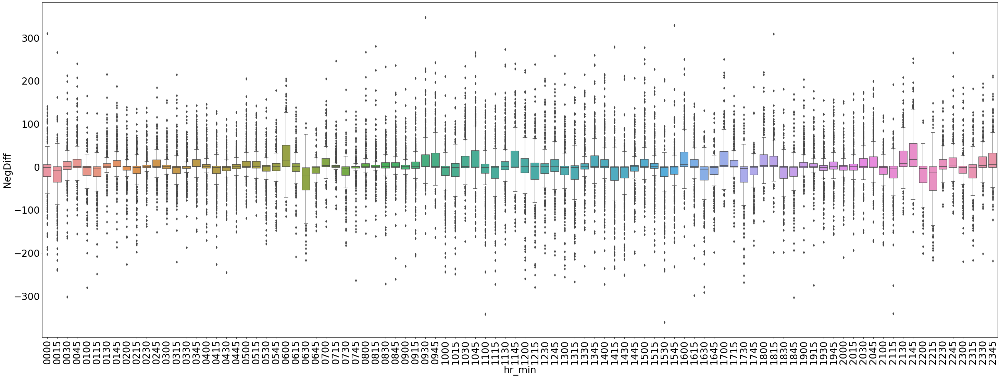

In [45]:
plt.xticks(rotation=90)
sns.boxplot(x='hr_min', y='NegDiff', data=df_30min)
plt.show()

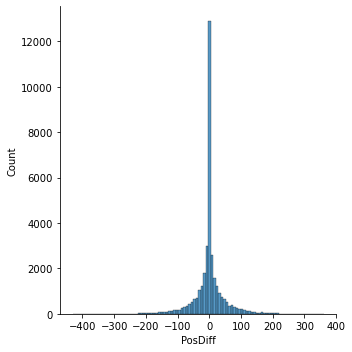

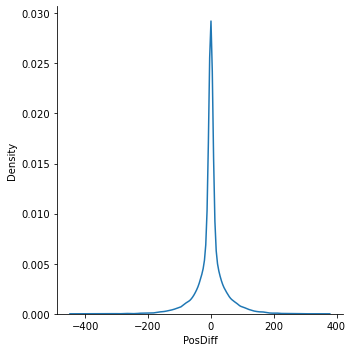

In [46]:
plt.rcParams.update({'font.size': 10})
sns.displot(df_30min, x="PosDiff", bins = 100)
sns.displot(df_30min, x="PosDiff", kind="kde")
plt.show()

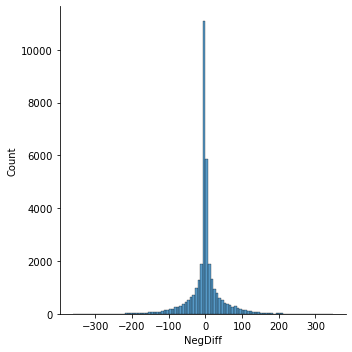

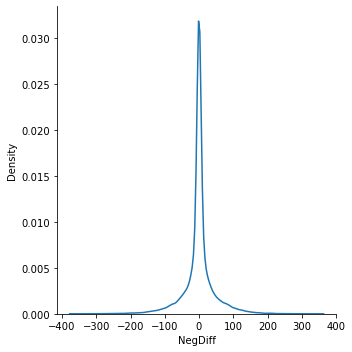

In [47]:
sns.displot(df_30min, x="NegDiff", bins = 100)
sns.displot(df_30min, x="NegDiff", kind="kde")
plt.show()

### New data frame for 45min increments

In [48]:
df_45min = pd.DataFrame()

df_45min = df.copy()
df_45min["PosDiff"] = df["Positive"].diff(periods = 3)
df_45min["NegDiff"] = df["Negative"].diff(periods = 3)
df_45min['hr_min'] = [d.strftime('%H%M') for d in df_45min.DateTime]
df_45min.head(10)

,DateTime,Positive,Negative,PosDiff,NegDiff,hr_min
0,2021-09-14 00:00:00,61,1,NaN,NaN,0000
1,2021-09-14 00:15:00,54,3,NaN,NaN,0015
2,2021-09-14 00:30:00,17,2,NaN,NaN,0030
3,2021-09-14 00:45:00,6,15,-55.0,14.0,0045
4,2021-09-14 01:00:00,17,6,-37.0,3.0,0100
5,2021-09-14 01:15:00,4,2,-13.0,0.0,0115
6,2021-09-14 01:30:00,32,1,26.0,-14.0,0130
7,2021-09-14 01:45:00,1,2,-16.0,-4.0,0145
8,2021-09-14 02:00:00,5,1,1.0,-1.0,0200
9,2021-09-14 02:15:00,3,2,-29.0,1.0,0215


In [49]:
df_45min.set_index('DateTime', inplace = True)

In [50]:
df_45min.describe()

,Positive,Negative,PosDiff,NegDiff
count,35136.000000,35136.000000,35133.000000,35133.000000
mean,25.876281,25.650074,-0.003330,0.004810
std,45.186696,44.515024,52.106547,48.140789
min,0.000000,0.000000,-438.000000,-364.000000
25%,1.000000,1.000000,-12.000000,-10.000000
50%,5.000000,5.000000,0.000000,0.000000
75%,31.000000,30.000000,12.000000,10.000000
max,460.000000,483.000000,456.000000,358.000000


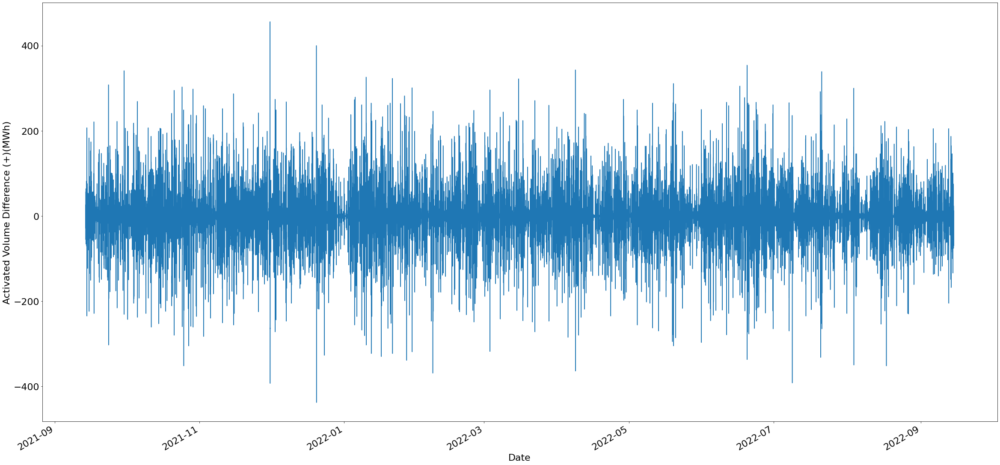

In [51]:
plt.rcParams["figure.figsize"] = (40,20)
plt.rcParams.update({'font.size': 22})
df_45min["PosDiff"].plot(xlabel="Date", ylabel="Activated Volume Difference (+)(MWh)")
plt.show()

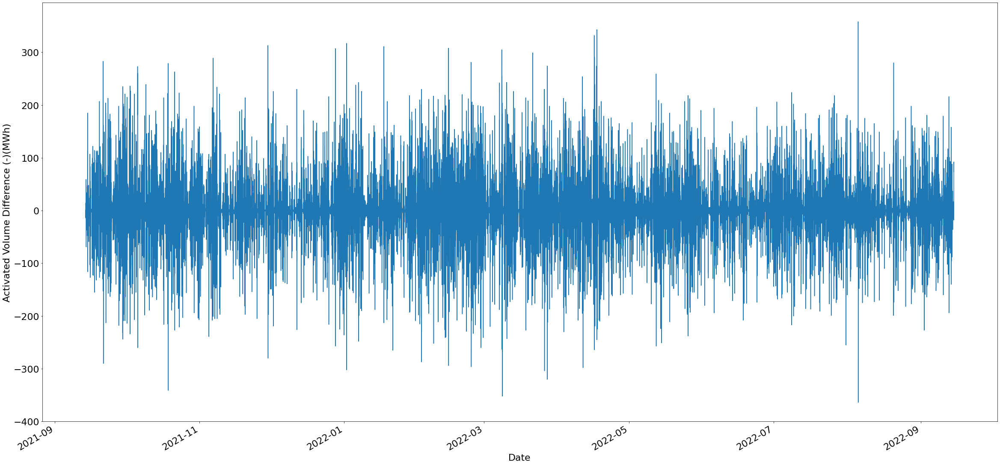

In [52]:
plt.rcParams["figure.figsize"] = (40,20)
df_45min["NegDiff"].plot(xlabel="Date", ylabel="Activated Volume Difference (-)(MWh)")
plt.show()

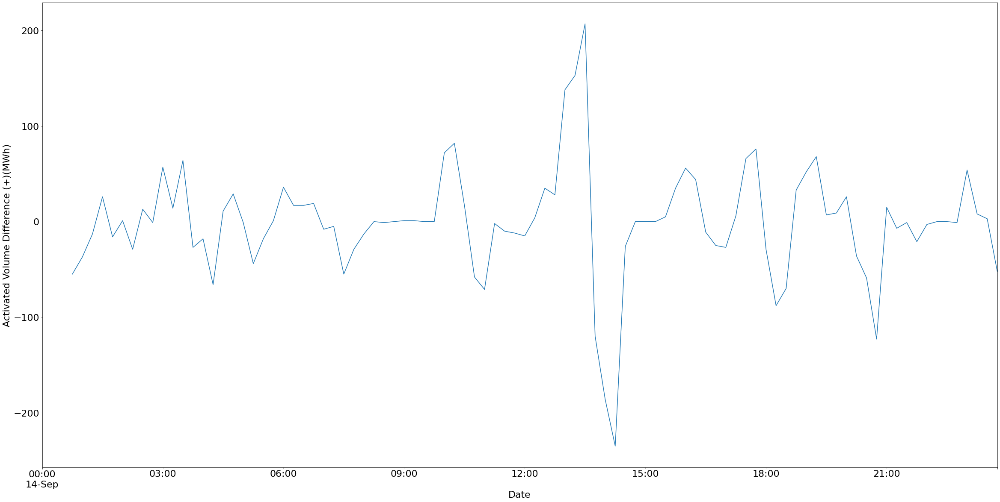

In [53]:
plt.rcParams["figure.figsize"] = (40,20)
plt.rcParams.update({'font.size': 22})
df_45min["PosDiff"].iloc[0:96].plot(xlabel="Date", ylabel="Activated Volume Difference (+)(MWh)")
plt.show()

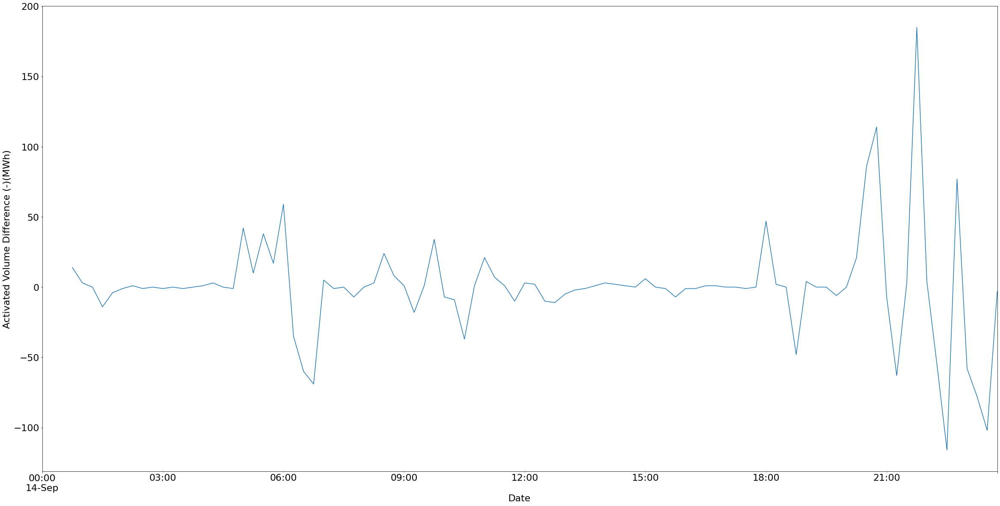

In [54]:
plt.rcParams["figure.figsize"] = (40,20)
df_45min["NegDiff"].iloc[0:96].plot(xlabel="Date", ylabel="Activated Volume Difference (-)(MWh)")
plt.show()

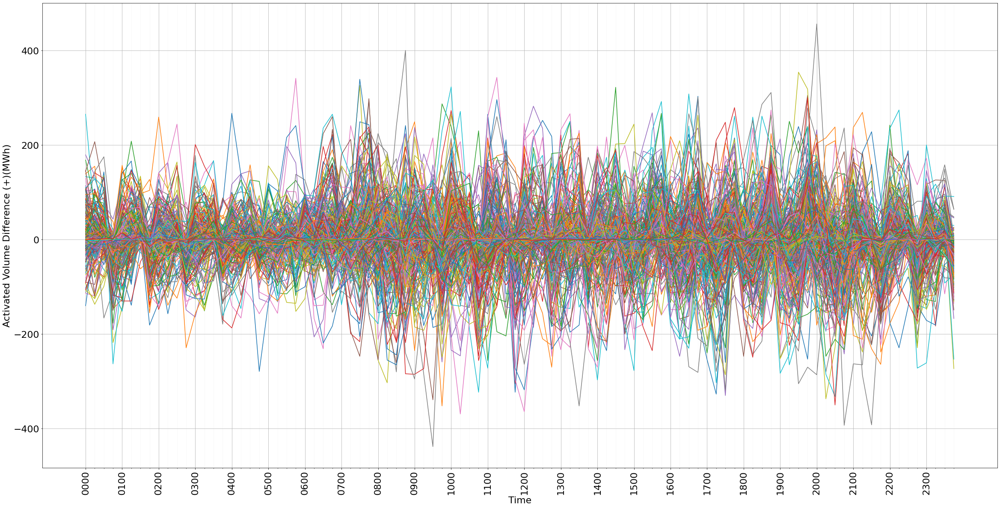

In [55]:
fig = plt.figure()
ax = fig.add_subplot(1, 1, 1)

plt.rcParams["figure.figsize"] = (50,18)
plt.rcParams.update({'font.size': 28})

i=0
for x in range(int(len(df_45min)/96)):
    plt.plot(df_45min["hr_min"].iloc[:96],df_45min["PosDiff"].iloc[i:i+96])
    i+=96
    
ax.set_xticks(df_45min["hr_min"].iloc[:96:4])
ax.set_xticks(df_45min["hr_min"].iloc[:96], minor = True)
    
plt.xticks(rotation=90)
plt.xlabel("Time")
plt.ylabel("Activated Volume Difference (+)(MWh)")
ax.grid(which='major', alpha=1)
ax.grid(which='minor', alpha=0.1)
plt.show()

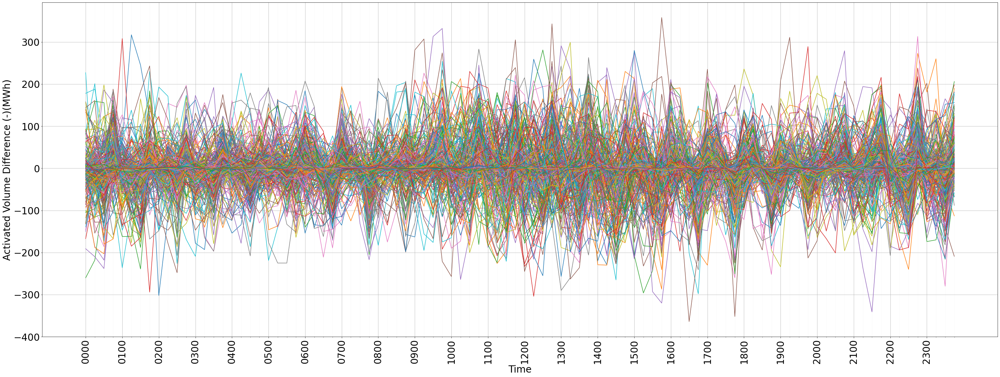

In [56]:
fig = plt.figure()
ax = fig.add_subplot(1, 1, 1)

plt.rcParams["figure.figsize"] = (50,18)
plt.rcParams.update({'font.size': 28})

i=0
for x in range(int(len(df_45min)/96)):
    plt.plot(df_45min["hr_min"].iloc[:96],df_45min["NegDiff"].iloc[i:i+96])
    i+=96
    
ax.set_xticks(df_45min["hr_min"].iloc[:96:4])
ax.set_xticks(df_45min["hr_min"].iloc[:96], minor = True)
    
plt.xticks(rotation=90)
plt.xlabel("Time")
plt.ylabel("Activated Volume Difference (-)(MWh)")
ax.grid(which='major', alpha=1)
ax.grid(which='minor', alpha=0.1)
plt.show()

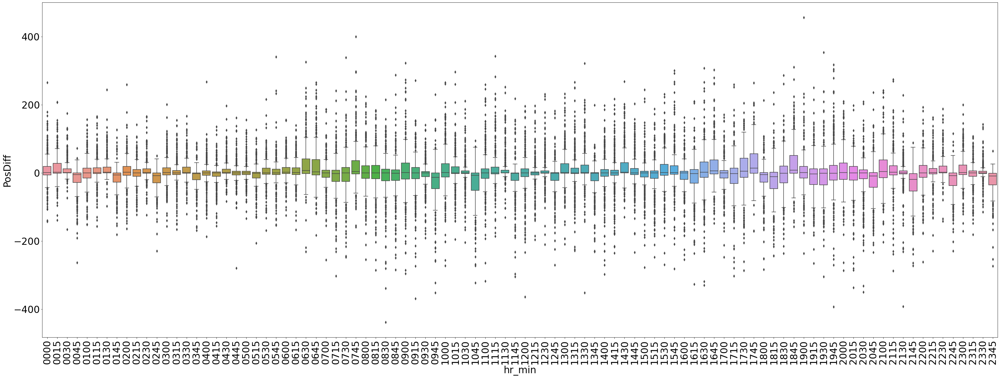

In [57]:
plt.xticks(rotation=90)
sns.boxplot(x='hr_min', y='PosDiff', data=df_45min)
plt.show()

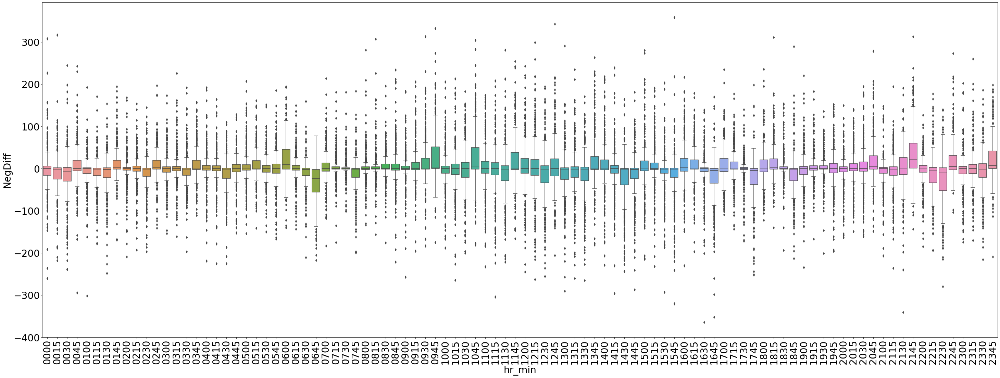

In [58]:
plt.xticks(rotation=90)
sns.boxplot(x='hr_min', y='NegDiff', data=df_45min)
plt.show()

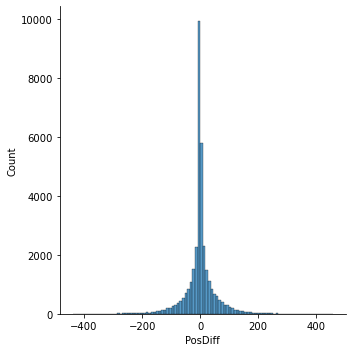

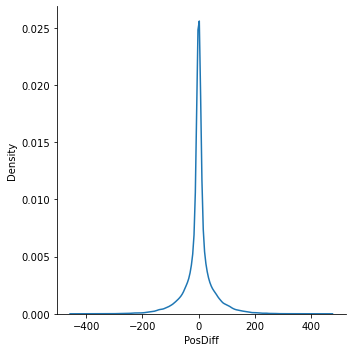

In [59]:
plt.rcParams.update({'font.size': 10})
sns.displot(df_45min, x="PosDiff", bins = 100)
sns.displot(df_45min, x="PosDiff", kind="kde")
plt.show()

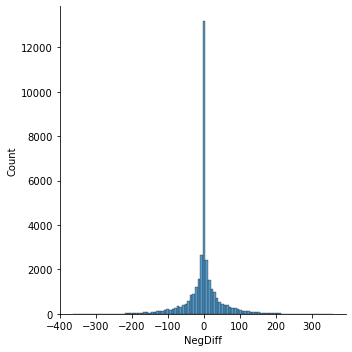

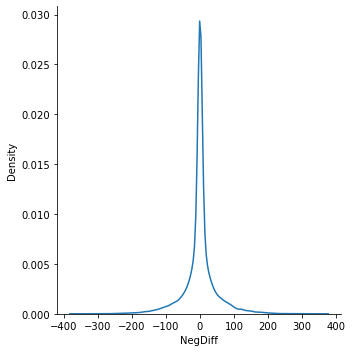

In [60]:
sns.displot(df_45min, x="NegDiff", bins = 100)
sns.displot(df_45min, x="NegDiff", kind="kde")
plt.show()

### New data frame for 1 hour increments

In [61]:
df_hr = pd.DataFrame()

df_hr = df.copy()
df_hr["PosDiff"] = df["Positive"].diff(periods = 4)
df_hr["NegDiff"] = df["Negative"].diff(periods = 4)
df_hr['hr_min'] = [d.strftime('%H%M') for d in df_hr.DateTime]
df_hr.head(10)

,DateTime,Positive,Negative,PosDiff,NegDiff,hr_min
0,2021-09-14 00:00:00,61,1,NaN,NaN,0000
1,2021-09-14 00:15:00,54,3,NaN,NaN,0015
2,2021-09-14 00:30:00,17,2,NaN,NaN,0030
3,2021-09-14 00:45:00,6,15,NaN,NaN,0045
4,2021-09-14 01:00:00,17,6,-44.0,5.0,0100
5,2021-09-14 01:15:00,4,2,-50.0,-1.0,0115
6,2021-09-14 01:30:00,32,1,15.0,-1.0,0130
7,2021-09-14 01:45:00,1,2,-5.0,-13.0,0145
8,2021-09-14 02:00:00,5,1,-12.0,-5.0,0200
9,2021-09-14 02:15:00,3,2,-1.0,0.0,0215


In [62]:
df_hr.set_index('DateTime', inplace = True)

In [63]:
df_hr.describe()

,Positive,Negative,PosDiff,NegDiff
count,35136.000000,35136.000000,35132.000000,35132.000000
mean,25.876281,25.650074,-0.003245,0.004412
std,45.186696,44.515024,52.646197,48.365407
min,0.000000,0.000000,-445.000000,-383.000000
25%,1.000000,1.000000,-11.000000,-10.000000
50%,5.000000,5.000000,0.000000,0.000000
75%,31.000000,30.000000,12.000000,10.000000
max,460.000000,483.000000,455.000000,351.000000


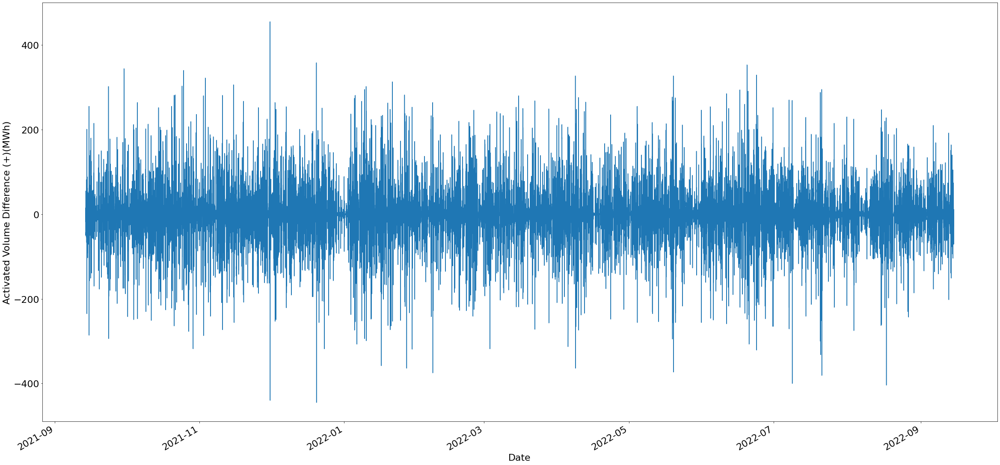

In [64]:
plt.rcParams["figure.figsize"] = (40,20)
plt.rcParams.update({'font.size': 22})
df_hr["PosDiff"].plot(xlabel="Date", ylabel="Activated Volume Difference (+)(MWh)")
plt.show()

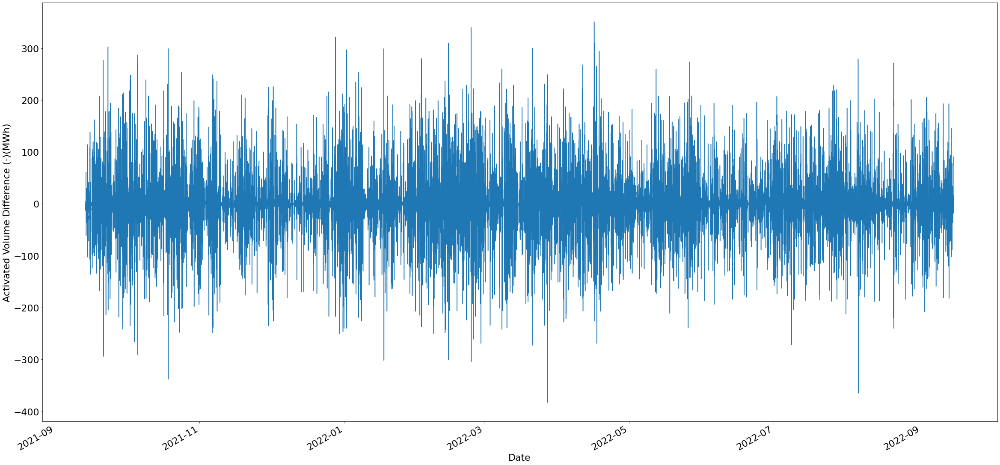

In [65]:
plt.rcParams["figure.figsize"] = (40,20)
df_hr["NegDiff"].plot(xlabel="Date", ylabel="Activated Volume Difference (-)(MWh)")
plt.show()

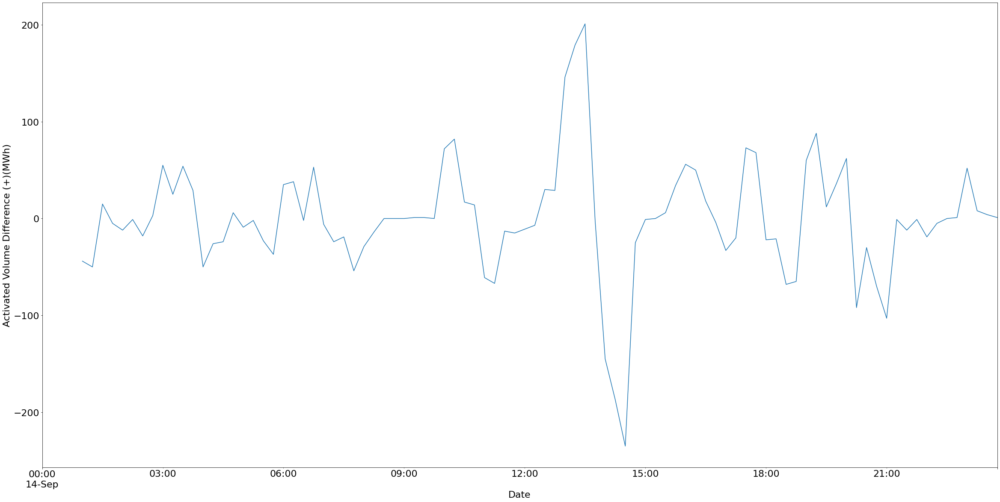

In [66]:
plt.rcParams["figure.figsize"] = (40,20)
plt.rcParams.update({'font.size': 22})
df_hr["PosDiff"].iloc[0:96].plot(xlabel="Date", ylabel="Activated Volume Difference (+)(MWh)")
plt.show()

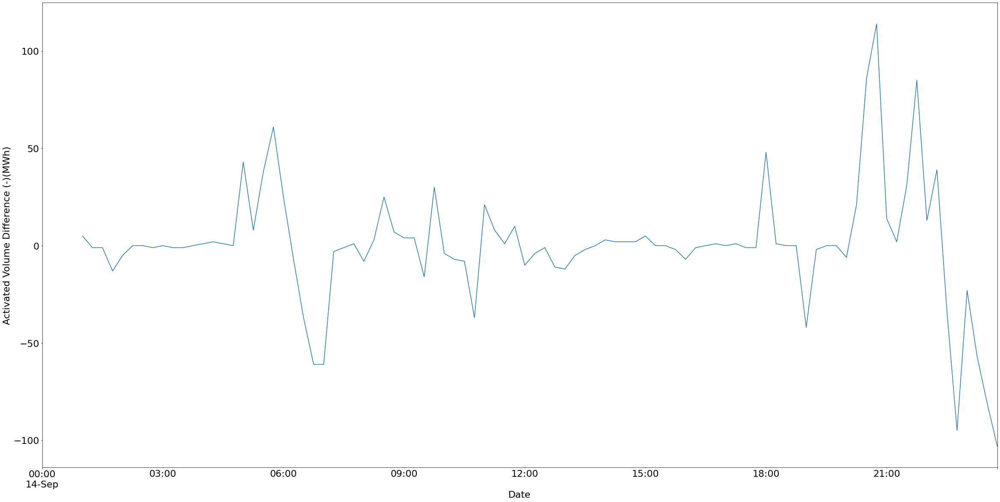

In [67]:
plt.rcParams["figure.figsize"] = (40,20)
df_hr["NegDiff"].iloc[0:96].plot(xlabel="Date", ylabel="Activated Volume Difference (-)(MWh)")
plt.show()

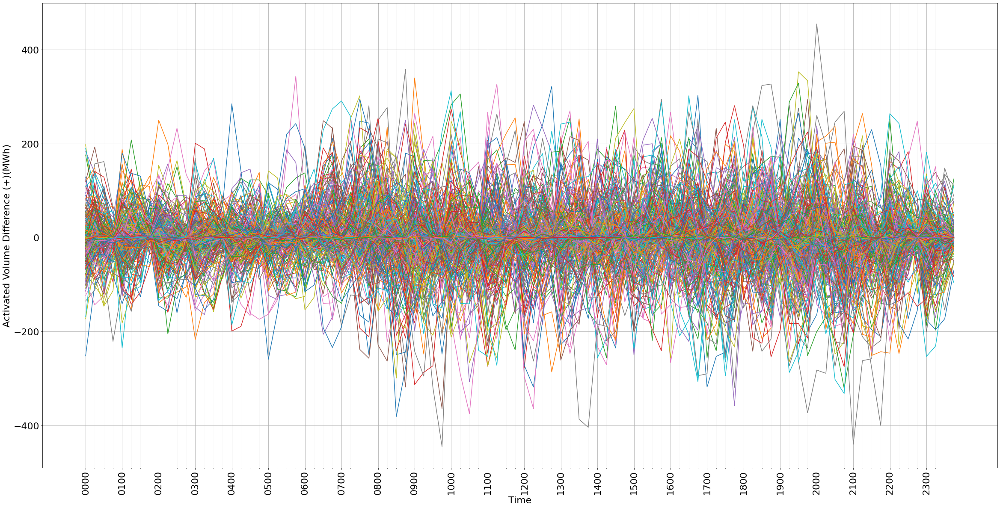

In [68]:
fig = plt.figure()
ax = fig.add_subplot(1, 1, 1)

plt.rcParams["figure.figsize"] = (50,18)
plt.rcParams.update({'font.size': 28})

i=0
for x in range(int(len(df_hr)/96)):
    plt.plot(df_hr["hr_min"].iloc[:96],df_hr["PosDiff"].iloc[i:i+96])
    i+=96
    
ax.set_xticks(df_hr["hr_min"].iloc[:96:4])
ax.set_xticks(df_hr["hr_min"].iloc[:96], minor = True)
    
plt.xticks(rotation=90)
plt.xlabel("Time")
plt.ylabel("Activated Volume Difference (+)(MWh)")
ax.grid(which='major', alpha=1)
ax.grid(which='minor', alpha=0.1)
plt.show()

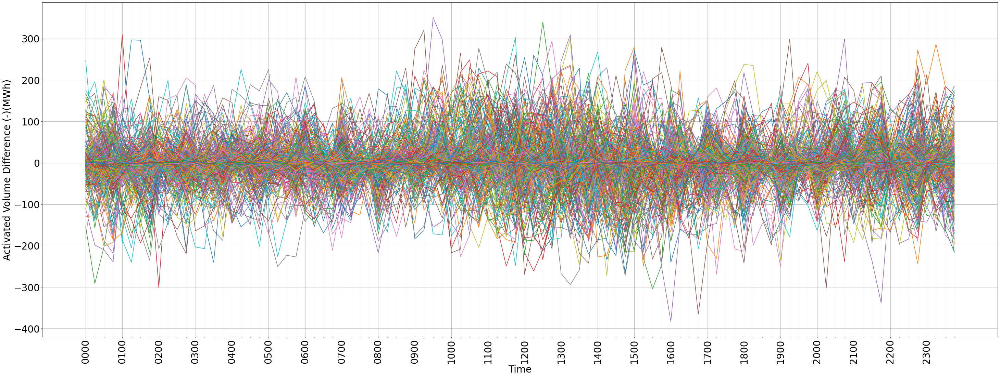

In [69]:
fig = plt.figure()
ax = fig.add_subplot(1, 1, 1)

plt.rcParams["figure.figsize"] = (50,18)
plt.rcParams.update({'font.size': 28})

i=0
for x in range(int(len(df_hr)/96)):
    plt.plot(df_hr["hr_min"].iloc[:96],df_hr["NegDiff"].iloc[i:i+96])
    i+=96
    
ax.set_xticks(df_hr["hr_min"].iloc[:96:4])
ax.set_xticks(df_hr["hr_min"].iloc[:96], minor = True)
    
plt.xticks(rotation=90)
plt.xlabel("Time")
plt.ylabel("Activated Volume Difference (-)(MWh)")
ax.grid(which='major', alpha=1)
ax.grid(which='minor', alpha=0.1)
plt.show()

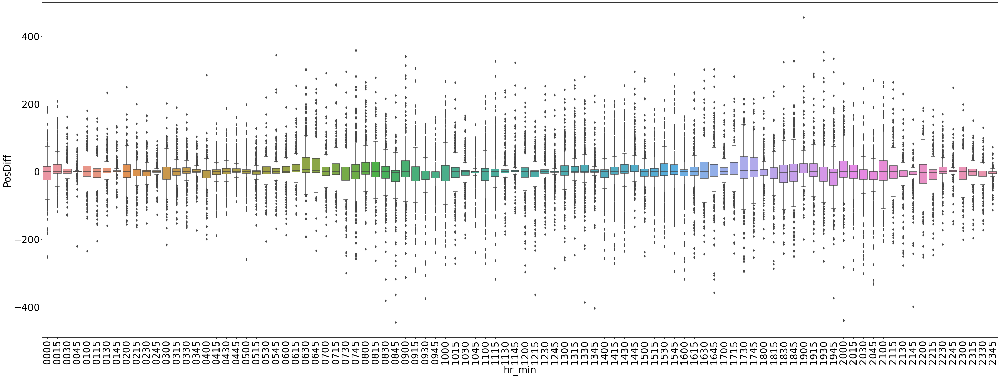

In [70]:
plt.xticks(rotation=90)
sns.boxplot(x='hr_min', y='PosDiff', data=df_hr)
plt.show()

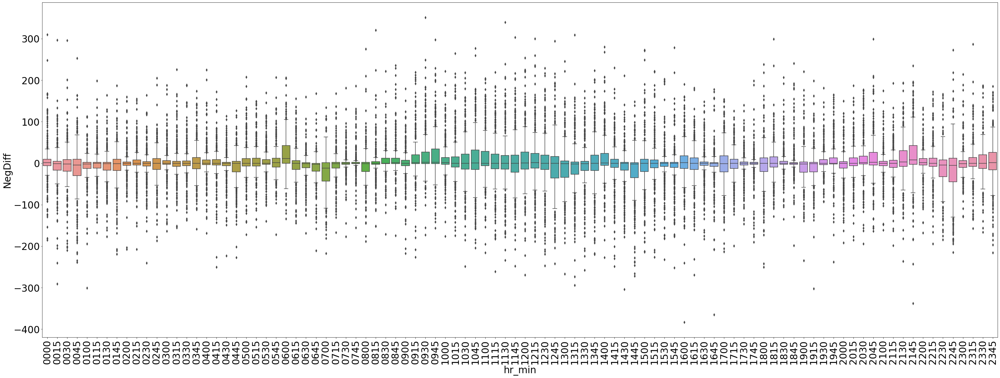

In [71]:
plt.xticks(rotation=90)
sns.boxplot(x='hr_min', y='NegDiff', data=df_hr)
plt.show()

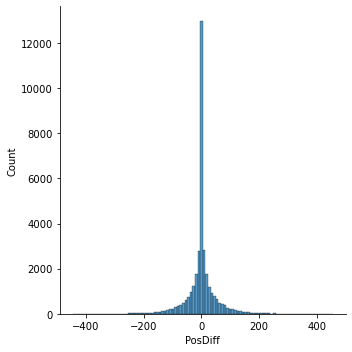

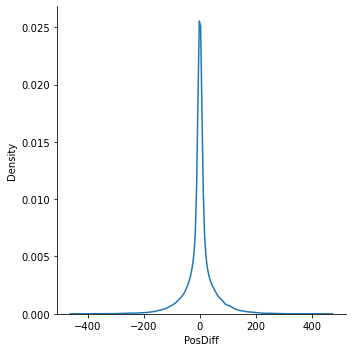

In [72]:
plt.rcParams.update({'font.size': 10})
sns.displot(df_hr, x="PosDiff", bins = 100)
sns.displot(df_hr, x="PosDiff", kind="kde")
plt.show()

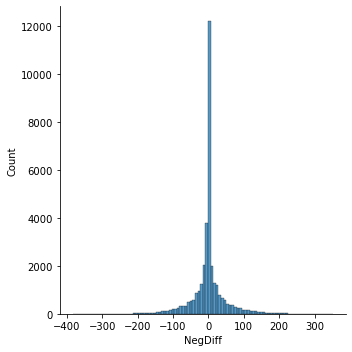

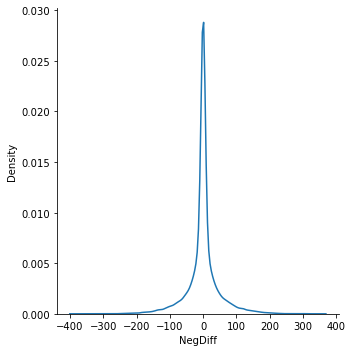

In [73]:
sns.displot(df_hr, x="NegDiff", bins = 100)
sns.displot(df_hr, x="NegDiff", kind="kde")
plt.show()

### New data frame for 90min increments

In [74]:
df_90min = pd.DataFrame()

df_90min = df.copy()
df_90min["PosDiff"] = df["Positive"].diff(periods = 5)
df_90min["NegDiff"] = df["Negative"].diff(periods = 5)
df_90min['hr_min'] = [d.strftime('%H%M') for d in df_90min.DateTime]
df_90min.head(10)

,DateTime,Positive,Negative,PosDiff,NegDiff,hr_min
0,2021-09-14 00:00:00,61,1,NaN,NaN,0000
1,2021-09-14 00:15:00,54,3,NaN,NaN,0015
2,2021-09-14 00:30:00,17,2,NaN,NaN,0030
3,2021-09-14 00:45:00,6,15,NaN,NaN,0045
4,2021-09-14 01:00:00,17,6,NaN,NaN,0100
5,2021-09-14 01:15:00,4,2,-57.0,1.0,0115
6,2021-09-14 01:30:00,32,1,-22.0,-2.0,0130
7,2021-09-14 01:45:00,1,2,-16.0,0.0,0145
8,2021-09-14 02:00:00,5,1,-1.0,-14.0,0200
9,2021-09-14 02:15:00,3,2,-14.0,-4.0,0215


In [75]:
df_90min.set_index('DateTime', inplace = True)

In [76]:
df_90min.describe()

,Positive,Negative,PosDiff,NegDiff
count,35136.000000,35136.000000,35131.000000,35131.000000
mean,25.876281,25.650074,-0.003359,0.004270
std,45.186696,44.515024,55.915369,52.057774
min,0.000000,0.000000,-439.000000,-390.000000
25%,1.000000,1.000000,-13.000000,-12.000000
50%,5.000000,5.000000,0.000000,0.000000
75%,31.000000,30.000000,13.000000,11.000000
max,460.000000,483.000000,443.000000,336.000000


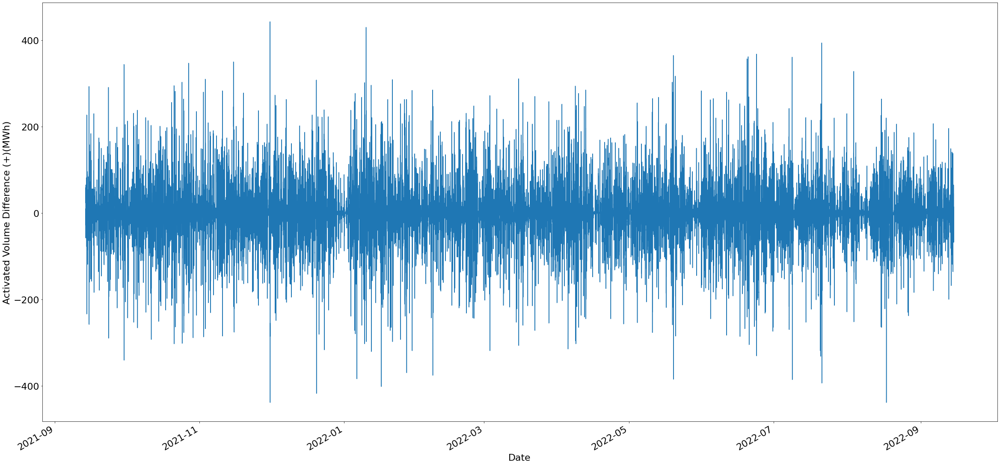

In [77]:
plt.rcParams["figure.figsize"] = (40,20)
plt.rcParams.update({'font.size': 22})
df_90min["PosDiff"].plot(xlabel="Date", ylabel="Activated Volume Difference (+)(MWh)")
plt.show()

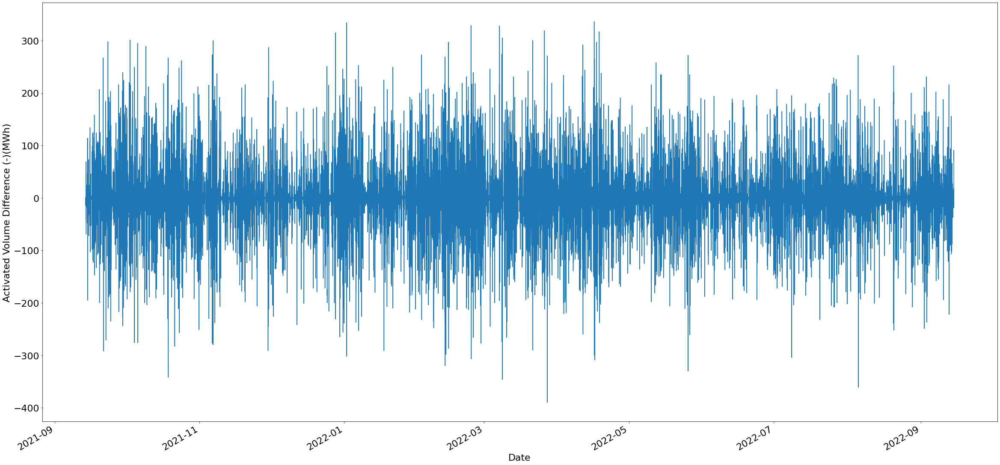

In [78]:
plt.rcParams["figure.figsize"] = (40,20)
df_90min["NegDiff"].plot(xlabel="Date", ylabel="Activated Volume Difference (-)(MWh)")
plt.show()

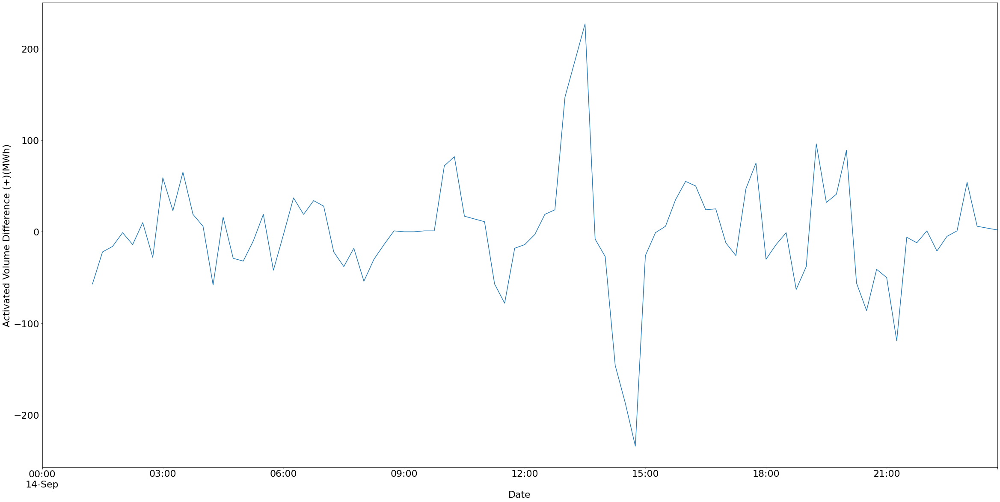

In [79]:
plt.rcParams["figure.figsize"] = (40,20)
plt.rcParams.update({'font.size': 22})
df_90min["PosDiff"].iloc[0:96].plot(xlabel="Date", ylabel="Activated Volume Difference (+)(MWh)")
plt.show()

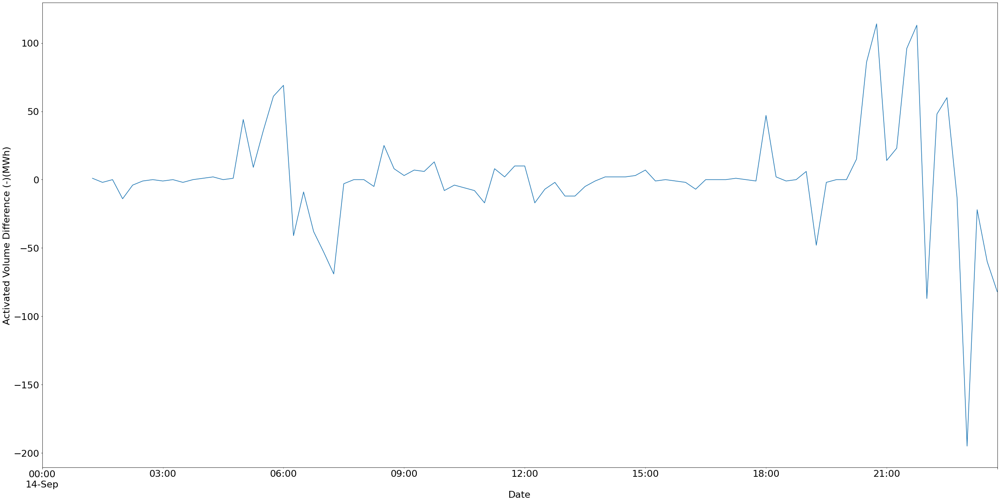

In [80]:
plt.rcParams["figure.figsize"] = (40,20)
df_90min["NegDiff"].iloc[0:96].plot(xlabel="Date", ylabel="Activated Volume Difference (-)(MWh)")
plt.show()

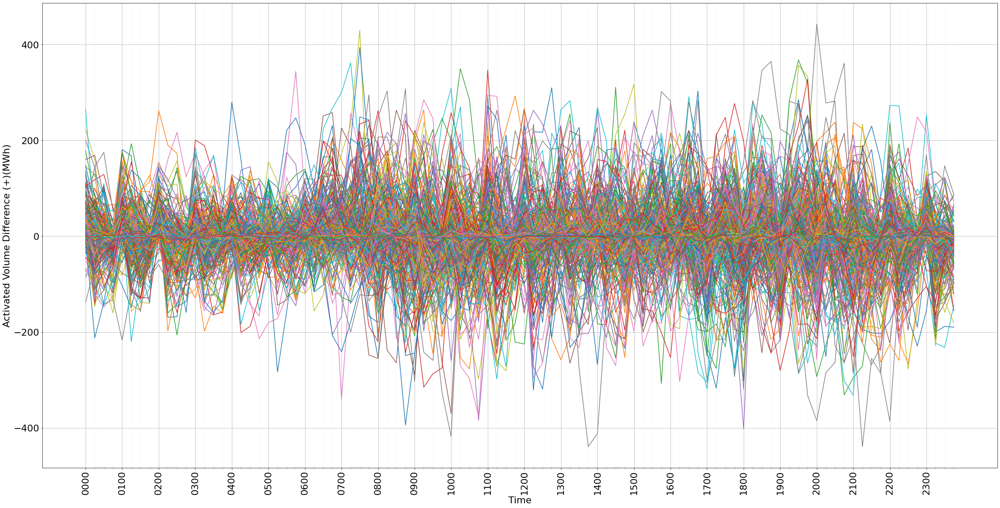

In [81]:
fig = plt.figure()
ax = fig.add_subplot(1, 1, 1)

plt.rcParams["figure.figsize"] = (50,18)
plt.rcParams.update({'font.size': 28})

i=0
for x in range(int(len(df_90min)/96)):
    plt.plot(df_90min["hr_min"].iloc[:96],df_90min["PosDiff"].iloc[i:i+96])
    i+=96
    
ax.set_xticks(df_90min["hr_min"].iloc[:96:4])
ax.set_xticks(df_90min["hr_min"].iloc[:96], minor = True)
    
plt.xticks(rotation=90)
plt.xlabel("Time")
plt.ylabel("Activated Volume Difference (+)(MWh)")
ax.grid(which='major', alpha=1)
ax.grid(which='minor', alpha=0.1)
plt.show()

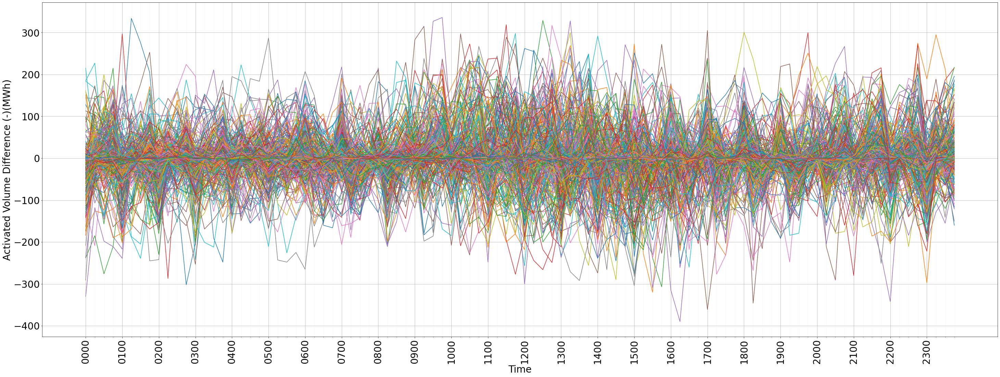

In [82]:
fig = plt.figure()
ax = fig.add_subplot(1, 1, 1)

plt.rcParams["figure.figsize"] = (50,18)
plt.rcParams.update({'font.size': 28})

i=0
for x in range(int(len(df_90min)/96)):
    plt.plot(df_90min["hr_min"].iloc[:96],df_90min["NegDiff"].iloc[i:i+96])
    i+=96
    
ax.set_xticks(df_90min["hr_min"].iloc[:96:4])
ax.set_xticks(df_90min["hr_min"].iloc[:96], minor = True)
    
plt.xticks(rotation=90)
plt.xlabel("Time")
plt.ylabel("Activated Volume Difference (-)(MWh)")
ax.grid(which='major', alpha=1)
ax.grid(which='minor', alpha=0.1)
plt.show()

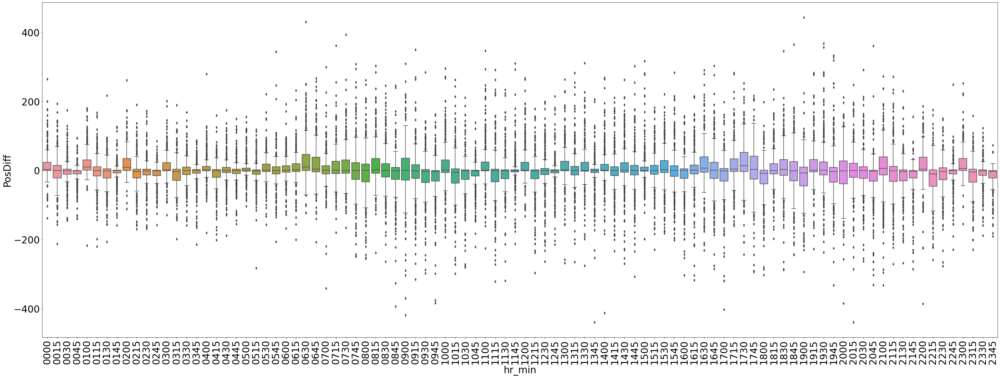

In [83]:
plt.xticks(rotation=90)
sns.boxplot(x='hr_min', y='PosDiff', data=df_90min)
plt.show()

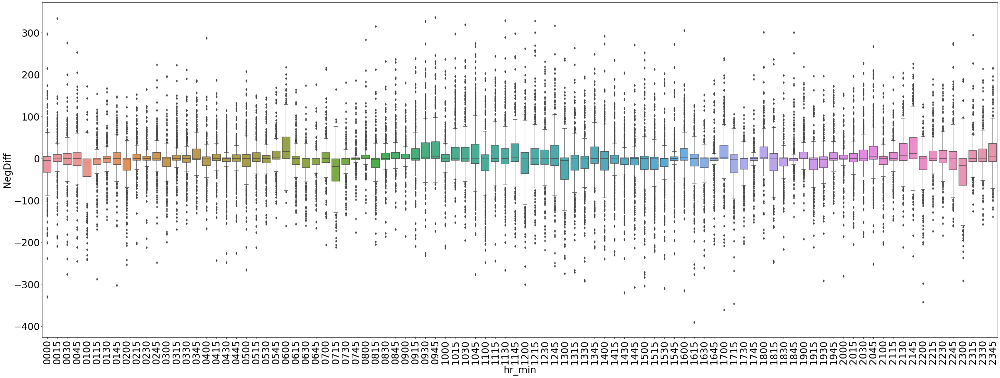

In [84]:
plt.xticks(rotation=90)
sns.boxplot(x='hr_min', y='NegDiff', data=df_90min)
plt.show()

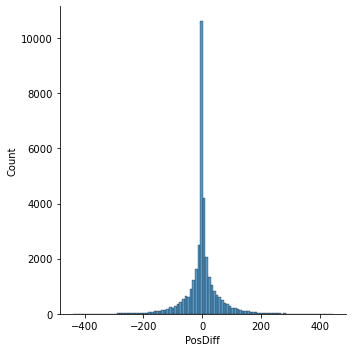

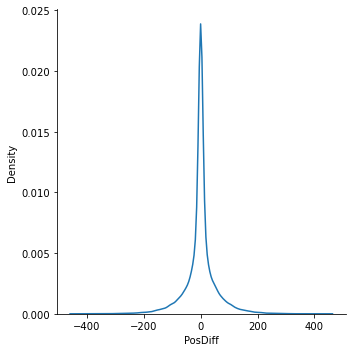

In [85]:
plt.rcParams.update({'font.size': 10})
sns.displot(df_90min, x="PosDiff", bins = 100)
sns.displot(df_90min, x="PosDiff", kind="kde")
plt.show()

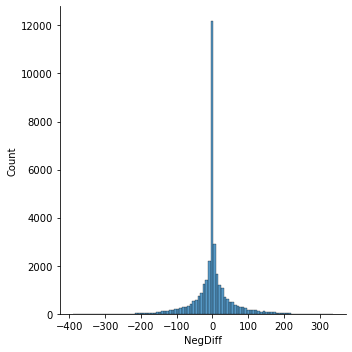

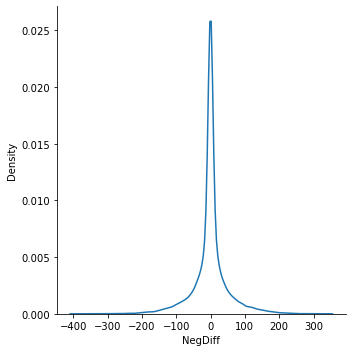

In [86]:
sns.displot(df_90min, x="NegDiff", bins = 100)
sns.displot(df_90min, x="NegDiff", kind="kde")
plt.show()

### New data frame for 120 min increments

In [87]:
df_2hr = pd.DataFrame()

df_2hr = df.copy()
df_2hr["PosDiff"] = df["Positive"].diff(periods = 6)
df_2hr["NegDiff"] = df["Negative"].diff(periods = 6)
df_2hr['hr_min'] = [d.strftime('%H%M') for d in df_2hr.DateTime]
df_2hr.head(10)

,DateTime,Positive,Negative,PosDiff,NegDiff,hr_min
0,2021-09-14 00:00:00,61,1,NaN,NaN,0000
1,2021-09-14 00:15:00,54,3,NaN,NaN,0015
2,2021-09-14 00:30:00,17,2,NaN,NaN,0030
3,2021-09-14 00:45:00,6,15,NaN,NaN,0045
4,2021-09-14 01:00:00,17,6,NaN,NaN,0100
5,2021-09-14 01:15:00,4,2,NaN,NaN,0115
6,2021-09-14 01:30:00,32,1,-29.0,0.0,0130
7,2021-09-14 01:45:00,1,2,-53.0,-1.0,0145
8,2021-09-14 02:00:00,5,1,-12.0,-1.0,0200
9,2021-09-14 02:15:00,3,2,-3.0,-13.0,0215


In [88]:
df_2hr.set_index('DateTime', inplace = True)

In [89]:
df_2hr.describe()

,Positive,Negative,PosDiff,NegDiff
count,35136.000000,35136.000000,35130.000000,35130.000000
mean,25.876281,25.650074,-0.003245,0.004270
std,45.186696,44.515024,57.773362,54.294337
min,0.000000,0.000000,-452.000000,-389.000000
25%,1.000000,1.000000,-14.000000,-12.000000
50%,5.000000,5.000000,0.000000,0.000000
75%,31.000000,30.000000,14.000000,12.000000
max,460.000000,483.000000,427.000000,352.000000


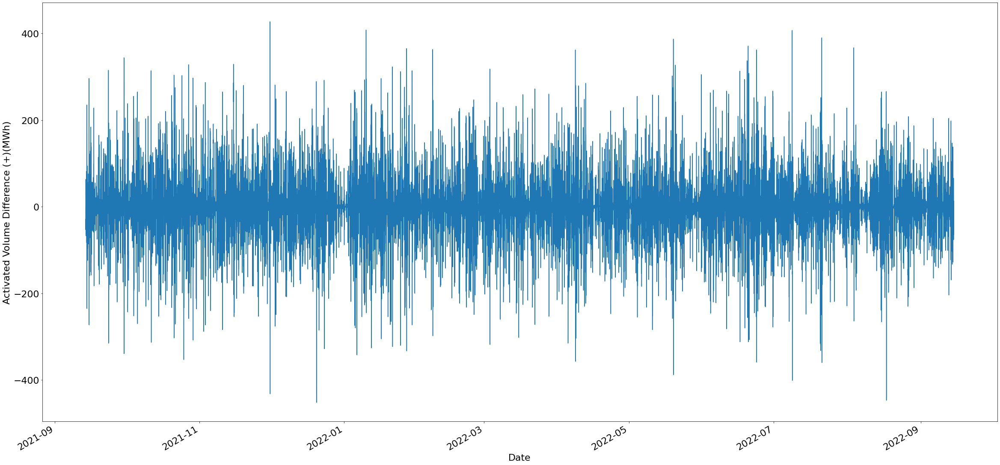

In [90]:
plt.rcParams["figure.figsize"] = (40,20)
plt.rcParams.update({'font.size': 22})
df_2hr["PosDiff"].plot(xlabel="Date", ylabel="Activated Volume Difference (+)(MWh)")
plt.show()

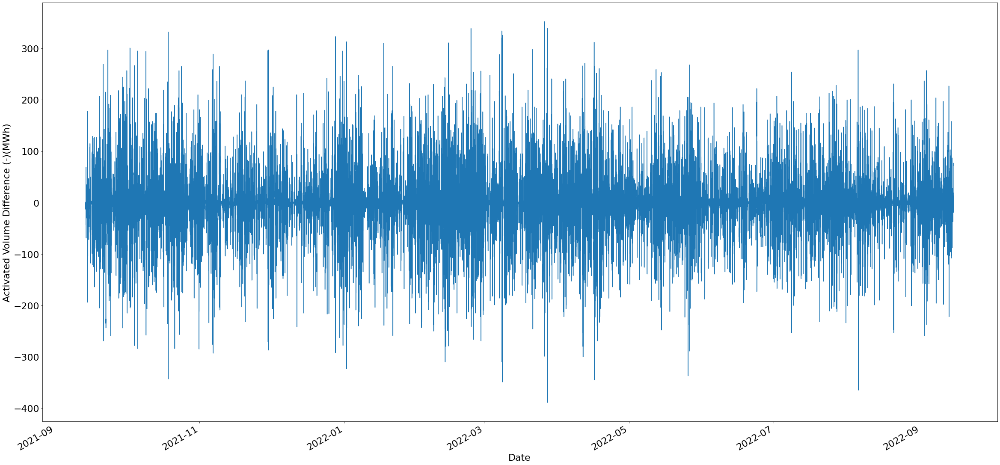

In [91]:
plt.rcParams["figure.figsize"] = (40,20)
df_2hr["NegDiff"].plot(xlabel="Date", ylabel="Activated Volume Difference (-)(MWh)")
plt.show()

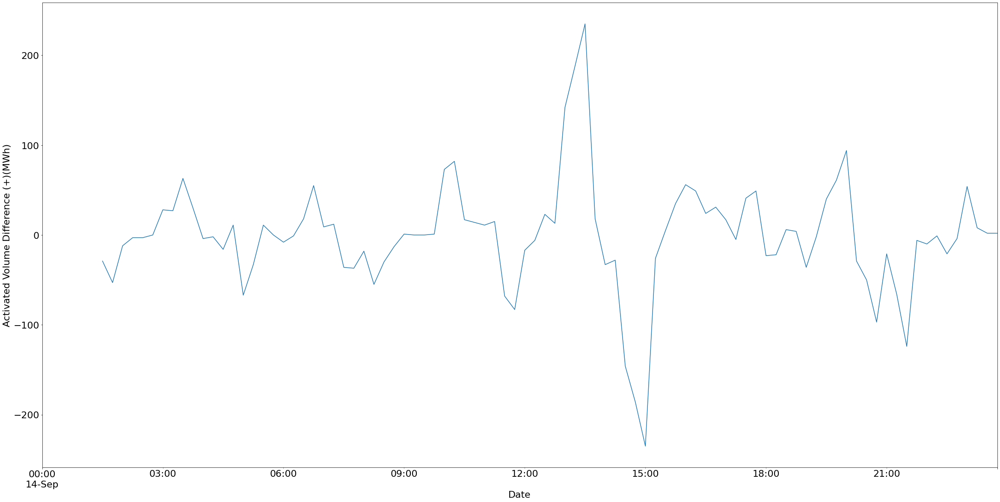

In [92]:
plt.rcParams["figure.figsize"] = (40,20)
plt.rcParams.update({'font.size': 22})
df_2hr["PosDiff"].iloc[0:96].plot(xlabel="Date", ylabel="Activated Volume Difference (+)(MWh)")
plt.show()

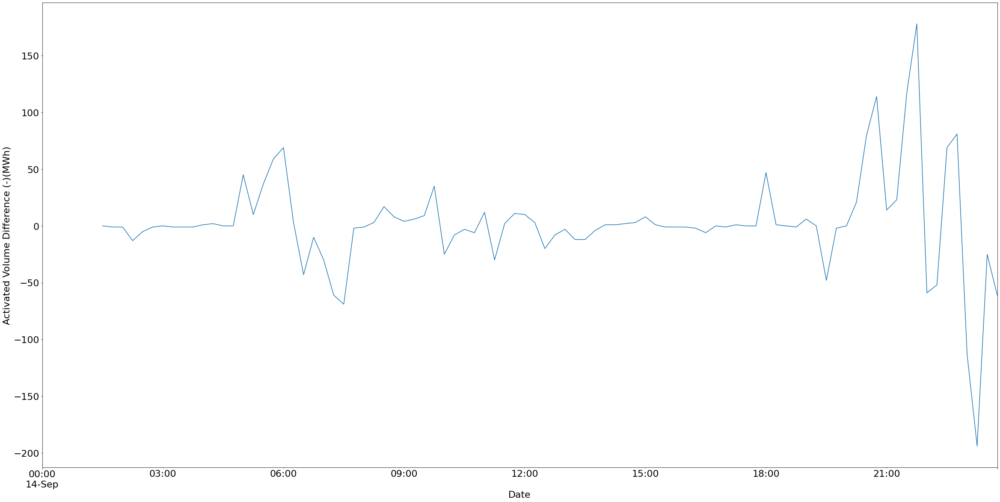

In [93]:
plt.rcParams["figure.figsize"] = (40,20)
df_2hr["NegDiff"].iloc[0:96].plot(xlabel="Date", ylabel="Activated Volume Difference (-)(MWh)")
plt.show()

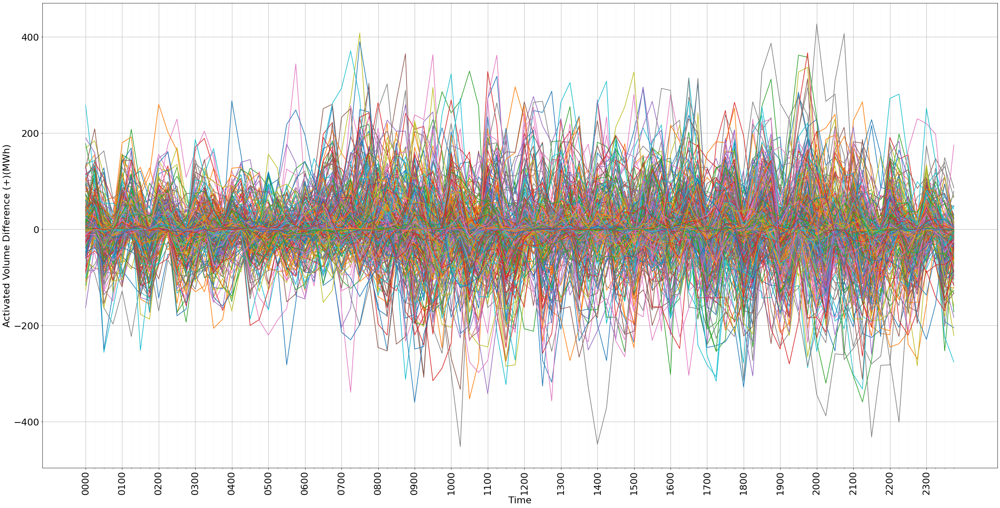

In [94]:
fig = plt.figure()
ax = fig.add_subplot(1, 1, 1)

plt.rcParams["figure.figsize"] = (50,18)
plt.rcParams.update({'font.size': 28})

i=0
for x in range(int(len(df_2hr)/96)):
    plt.plot(df_2hr["hr_min"].iloc[:96],df_2hr["PosDiff"].iloc[i:i+96])
    i+=96
    
ax.set_xticks(df_2hr["hr_min"].iloc[:96:4])
ax.set_xticks(df_2hr["hr_min"].iloc[:96], minor = True)
    
plt.xticks(rotation=90)
plt.xlabel("Time")
plt.ylabel("Activated Volume Difference (+)(MWh)")
ax.grid(which='major', alpha=1)
ax.grid(which='minor', alpha=0.1)
plt.show()

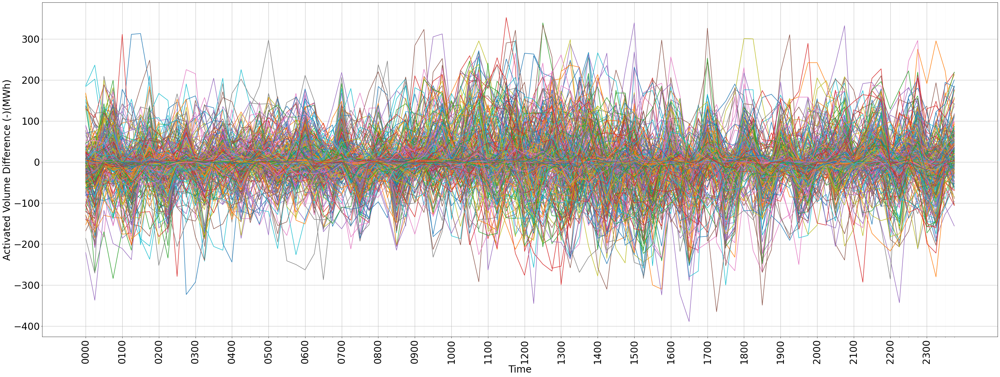

In [95]:
fig = plt.figure()
ax = fig.add_subplot(1, 1, 1)

plt.rcParams["figure.figsize"] = (50,18)
plt.rcParams.update({'font.size': 28})

i=0
for x in range(int(len(df_2hr)/96)):
    plt.plot(df_2hr["hr_min"].iloc[:96],df_2hr["NegDiff"].iloc[i:i+96])
    i+=96
    
ax.set_xticks(df_2hr["hr_min"].iloc[:96:4])
ax.set_xticks(df_2hr["hr_min"].iloc[:96], minor = True)
    
plt.xticks(rotation=90)
plt.xlabel("Time")
plt.ylabel("Activated Volume Difference (-)(MWh)")
ax.grid(which='major', alpha=1)
ax.grid(which='minor', alpha=0.1)
plt.show()

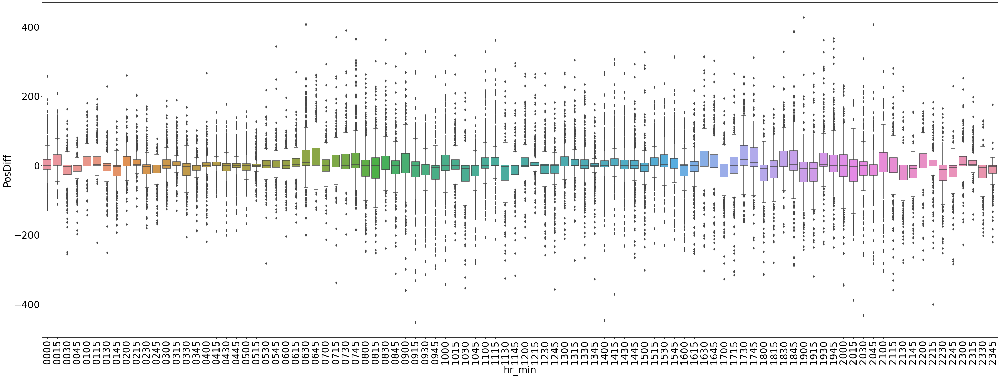

In [96]:
plt.xticks(rotation=90)
sns.boxplot(x='hr_min', y='PosDiff', data=df_2hr)
plt.show()

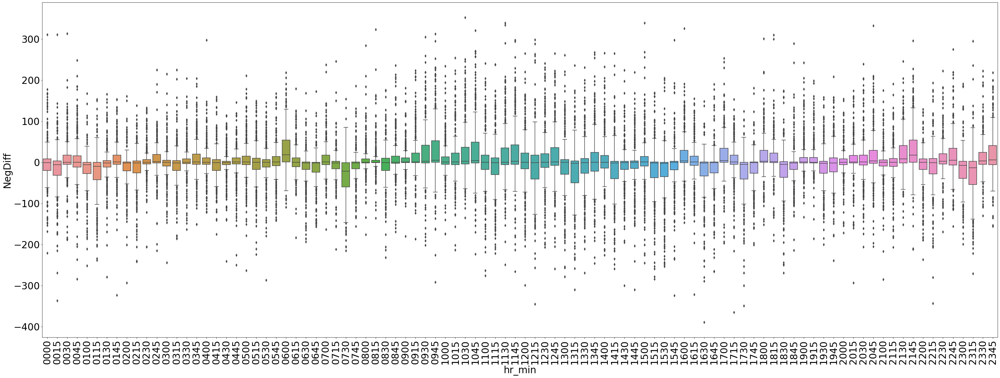

In [97]:
plt.xticks(rotation=90)
sns.boxplot(x='hr_min', y='NegDiff', data=df_2hr)
plt.show()

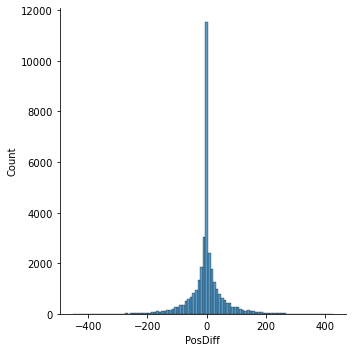

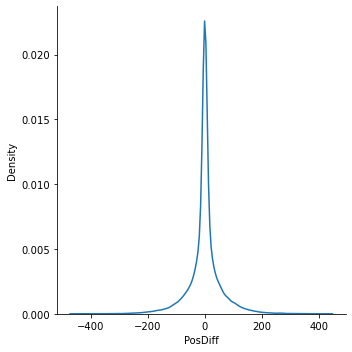

In [98]:
plt.rcParams.update({'font.size': 10})
sns.displot(df_2hr, x="PosDiff", bins = 100)
sns.displot(df_2hr, x="PosDiff", kind="kde")
plt.show()

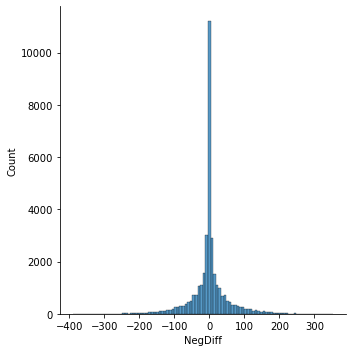

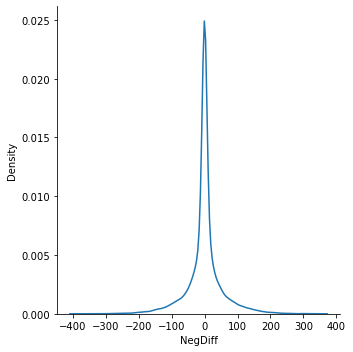

In [99]:
sns.displot(df_2hr, x="NegDiff", bins = 100)
sns.displot(df_2hr, x="NegDiff", kind="kde")
plt.show()

# Forecasting

In [100]:
df_decompose = df_15min.copy()
df_decompose = df_decompose.dropna()

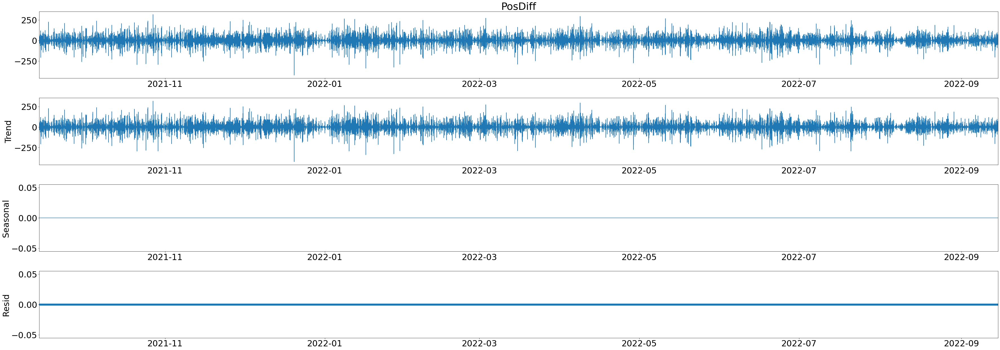

In [101]:
def decompose_time_series(series):
    """
    Decompose a time series and plot it in the console
    Arguments: 
        series: series. Time series that we want to decompose
    Outputs: 
        Decomposition plot in the console
    """
    result = sm.seasonal_decompose(series, model='additive', period=1)
    plt.rcParams.update({'font.size': 30})
    result.plot()
    plt.show()

decompose_time_series(df_decompose['PosDiff'])

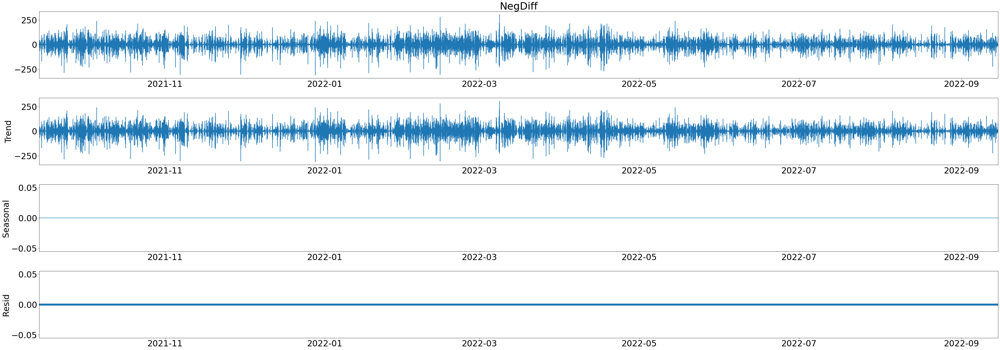

In [102]:
decompose_time_series(df_decompose['NegDiff'])

In [103]:
copydf = df_15min.copy().reset_index()

## LSTM

In [104]:
# fix random seed for reproducibility
tf.random.set_seed(7)

In [105]:
dataset = df_15min["PosDiff"].copy()
dataset = dataset.values
dataset = dataset.astype('float32')
dataset = dataset[~np.isnan(dataset)]
dataset

array([ -7., -37., -11., ...,   6., -15.,   0.], dtype=float32)

In [106]:
# normalize the dataset
scaler = MinMaxScaler(feature_range=(0, 1))
dataset = scaler.fit_transform(dataset.reshape(-1, 1))


In [107]:
# split into train and test sets
train_size = int(len(dataset) * 0.80)
test_size = len(dataset) - train_size
train, test = dataset[0:train_size,:], dataset[train_size:len(dataset),:]
print(len(train), len(test))

28108 7027


In [108]:
# convert an array of values into a dataset matrix
def create_dataset(dataset, look_back=1):
    dataX, dataY = [], []
    for i in range(len(dataset)-look_back-1):
        a = dataset[i:(i+look_back), 0]
        dataX.append(a)
        dataY.append(dataset[i + look_back, 0])
    return np.array(dataX), np.array(dataY)

In [109]:
# reshape into X=t and Y=t+1
look_back = 1
trainX, trainY = create_dataset(train, look_back)
testX, testY = create_dataset(test, look_back)

In [110]:
# reshape input to be [samples, time steps, features]
trainX = np.reshape(trainX, (trainX.shape[0], 1, trainX.shape[1]))
testX = np.reshape(testX, (testX.shape[0], 1, testX.shape[1]))

In [111]:
# create and fit the LSTM network
model = Sequential()
model.add(LSTM(4, input_shape=(1, look_back)))
model.add(Dense(1))
model.compile(loss='mean_squared_error', optimizer='adam')
model.fit(trainX, trainY, epochs=10, batch_size=1, verbose=2)

Epoch 1/10
28106/28106 - 22s - loss: 0.0040 - 22s/epoch - 798us/step
Epoch 2/10
28106/28106 - 21s - loss: 0.0026 - 21s/epoch - 735us/step
Epoch 3/10
28106/28106 - 20s - loss: 0.0026 - 20s/epoch - 724us/step
Epoch 4/10
28106/28106 - 21s - loss: 0.0026 - 21s/epoch - 736us/step
Epoch 5/10
28106/28106 - 20s - loss: 0.0026 - 20s/epoch - 727us/step
Epoch 6/10
28106/28106 - 20s - loss: 0.0026 - 20s/epoch - 713us/step
Epoch 7/10
28106/28106 - 21s - loss: 0.0026 - 21s/epoch - 743us/step
Epoch 8/10
28106/28106 - 21s - loss: 0.0026 - 21s/epoch - 736us/step
Epoch 9/10
28106/28106 - 21s - loss: 0.0026 - 21s/epoch - 747us/step
Epoch 10/10
28106/28106 - 21s - loss: 0.0026 - 21s/epoch - 732us/step


In [112]:
# make predictions
trainPredict = model.predict(trainX)
testPredict = model.predict(testX)
# invert predictions
trainPredict = scaler.inverse_transform(trainPredict)
trainY = scaler.inverse_transform([trainY])
testPredict = scaler.inverse_transform(testPredict)
testY = scaler.inverse_transform([testY])
# calculate root mean squared error
trainScore = np.sqrt(mean_squared_error(trainY[0], trainPredict[:,0]))
print('Train Score: %.2f RMSE' % (trainScore))
testScore = np.sqrt(mean_squared_error(testY[0], testPredict[:,0]))
print('Test Score: %.2f RMSE' % (testScore))

Train Score: 37.20 RMSE
Test Score: 30.32 RMSE


In [113]:
# shift train predictions for plotting
trainPredictPlot = np.empty_like(dataset)
trainPredictPlot[:, :] = np.nan
trainPredictPlot[look_back:len(trainPredict)+look_back, :] = trainPredict
# shift test predictions for plotting
testPredictPlot = np.empty_like(dataset)
testPredictPlot[:, :] = np.nan
testPredictPlot[len(trainPredict)+(look_back*2)+1:len(dataset)-1, :] = testPredict

Text(0, 0.5, 'Activated Volume Difference (+)(MWh)')

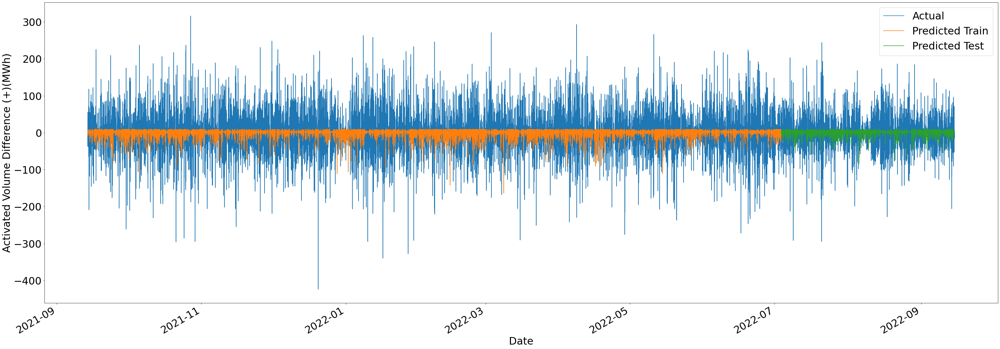

In [132]:
pos_plot = pd.DataFrame()
pos_plot["DateTime"] = df["DateTime"]
pos_plot["Actual"] = copydf["PosDiff"].copy()

trainPredcomp = np.array(np.nan)
trainPredcomp = np.append(trainPredcomp,trainPredictPlot)

testPredcomp = np.array(np.nan)
testPredcomp = np.append(testPredcomp,testPredictPlot)

pos_plot["Predicted Train"] = trainPredcomp
pos_plot["Predicted Test"] = testPredcomp
pos_plot.set_index('DateTime', inplace = True)
ax = pos_plot.plot(legend=True)
ax.set_xlabel("Date")
ax.set_ylabel("Activated Volume Difference (+)(MWh)")

In [115]:
scaler.inverse_transform(dataset)

array([[ -6.9999824],
       [-37.000008 ],
       [-10.999997 ],
       ...,
       [  5.9999785],
       [-15.000012 ],
       [  0.       ]], dtype=float32)

In [116]:
# fix random seed for reproducibility
tf.random.set_seed(8)

In [117]:
dataset = df_15min["NegDiff"].copy()
dataset = dataset.values
dataset = dataset.astype('float32')
dataset = dataset[~np.isnan(dataset)]
dataset

array([  2.,  -1.,  13., ...,   7.,  85., -19.], dtype=float32)

In [118]:
# normalize the dataset
scaler = MinMaxScaler(feature_range=(0, 1))
dataset = scaler.fit_transform(dataset.reshape(-1, 1))


In [119]:
# split into train and test sets
train_size = int(len(dataset) * 0.80)
test_size = len(dataset) - train_size
train, test = dataset[0:train_size,:], dataset[train_size:len(dataset),:]
print(len(train), len(test))

28108 7027


In [120]:
# convert an array of values into a dataset matrix
def create_dataset(dataset, look_back=1):
    dataX, dataY = [], []
    for i in range(len(dataset)-look_back-1):
        a = dataset[i:(i+look_back), 0]
        dataX.append(a)
        dataY.append(dataset[i + look_back, 0])
    return np.array(dataX), np.array(dataY)

In [121]:
# reshape into X=t and Y=t+1
look_back = 1
trainX, trainY = create_dataset(train, look_back)
testX, testY = create_dataset(test, look_back)

In [122]:
# reshape input to be [samples, time steps, features]
trainX = np.reshape(trainX, (trainX.shape[0], 1, trainX.shape[1]))
testX = np.reshape(testX, (testX.shape[0], 1, testX.shape[1]))

In [123]:
# create and fit the LSTM network
model = Sequential()
model.add(LSTM(4, input_shape=(1, look_back)))
model.add(Dense(1))
model.compile(loss='mean_squared_error', optimizer='adam')
model.fit(trainX, trainY, epochs=10, batch_size=1, verbose=2)

Epoch 1/10
28106/28106 - 23s - loss: 0.0043 - 23s/epoch - 813us/step
Epoch 2/10
28106/28106 - 21s - loss: 0.0035 - 21s/epoch - 737us/step
Epoch 3/10
28106/28106 - 21s - loss: 0.0035 - 21s/epoch - 751us/step
Epoch 4/10
28106/28106 - 21s - loss: 0.0034 - 21s/epoch - 751us/step
Epoch 5/10
28106/28106 - 21s - loss: 0.0034 - 21s/epoch - 736us/step
Epoch 6/10
28106/28106 - 20s - loss: 0.0034 - 20s/epoch - 724us/step
Epoch 7/10
28106/28106 - 21s - loss: 0.0034 - 21s/epoch - 747us/step
Epoch 8/10
28106/28106 - 21s - loss: 0.0034 - 21s/epoch - 743us/step
Epoch 9/10
28106/28106 - 22s - loss: 0.0034 - 22s/epoch - 796us/step
Epoch 10/10
28106/28106 - 21s - loss: 0.0033 - 21s/epoch - 754us/step


In [124]:
# make predictions
trainPredict = model.predict(trainX)
testPredict = model.predict(testX)
# invert predictions
trainPredict = scaler.inverse_transform(trainPredict)
trainY = scaler.inverse_transform([trainY])
testPredict = scaler.inverse_transform(testPredict)
testY = scaler.inverse_transform([testY])
# calculate root mean squared error
trainScore = np.sqrt(mean_squared_error(trainY[0], trainPredict[:,0]))
print('Train Score: %.2f RMSE' % (trainScore))
testScore = np.sqrt(mean_squared_error(testY[0], testPredict[:,0]))
print('Test Score: %.2f RMSE' % (testScore))

Train Score: 35.46 RMSE
Test Score: 28.17 RMSE


In [125]:
# shift train predictions for plotting
trainPredictPlot = np.empty_like(dataset)
trainPredictPlot[:, :] = np.nan
trainPredictPlot[look_back:len(trainPredict)+look_back, :] = trainPredict
# shift test predictions for plotting
testPredictPlot = np.empty_like(dataset)
testPredictPlot[:, :] = np.nan
testPredictPlot[len(trainPredict)+(look_back*2)+1:len(dataset)-1, :] = testPredict

Text(0, 0.5, 'Activated Volume Difference (-)(MWh)')

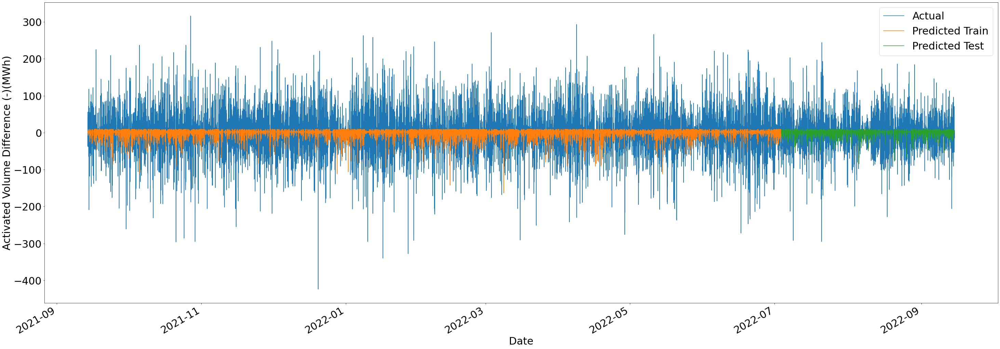

In [126]:
neg_plot = pd.DataFrame()
neg_plot["DateTime"] = df["DateTime"]
neg_plot["Actual"] = copydf["PosDiff"].copy()

trainPredcomp=np.array(np.nan)
trainPredcomp=np.append(trainPredcomp,trainPredictPlot)

testPredcomp = np.array(np.nan)
testPredcomp=np.append(testPredcomp,testPredictPlot)

neg_plot["Predicted Train"] = trainPredcomp
neg_plot["Predicted Test"] = testPredcomp
neg_plot.set_index('DateTime', inplace = True)
ax = neg_plot.plot(legend=True)
ax.set_xlabel("Date")
ax.set_ylabel("Activated Volume Difference (-)(MWh)")

## ARIMA

In [127]:
train, test = train_test_split(df_15min, test_size=0.2, shuffle = False)
test

,Positive,Negative,PosDiff,NegDiff,hr_min
DateTime,,,,,
2022-07-03 19:00:00,7,60,-4.0,53.0,1900
2022-07-03 19:15:00,16,41,9.0,-19.0,1915
2022-07-03 19:30:00,28,10,12.0,-31.0,1930
2022-07-03 19:45:00,13,4,-15.0,-6.0,1945
2022-07-03 20:00:00,2,23,-11.0,19.0,2000
...,...,...,...,...,...
2022-09-14 22:45:00,13,1,5.0,-1.0,2245
2022-09-14 23:00:00,9,1,-4.0,0.0,2300
2022-09-14 23:15:00,15,8,6.0,7.0,2315


In [128]:
model_arima = auto_arima(
    train["PosDiff"].iloc[1:],
    trace=True,
    error_action="ignore",
    suppress_warnings=True)

Performing stepwise search to minimize aic
 ARIMA(2,0,2)(0,0,0)[0] intercept   : AIC=inf, Time=26.65 sec
 ARIMA(0,0,0)(0,0,0)[0] intercept   : AIC=284080.719, Time=0.35 sec
 ARIMA(1,0,0)(0,0,0)[0] intercept   : AIC=283438.043, Time=0.44 sec
 ARIMA(0,0,1)(0,0,0)[0] intercept   : AIC=282776.643, Time=3.18 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=284078.719, Time=0.19 sec
 ARIMA(1,0,1)(0,0,0)[0] intercept   : AIC=inf, Time=7.65 sec
 ARIMA(0,0,2)(0,0,0)[0] intercept   : AIC=280422.656, Time=4.34 sec
 ARIMA(1,0,2)(0,0,0)[0] intercept   : AIC=inf, Time=9.51 sec
 ARIMA(0,0,3)(0,0,0)[0] intercept   : AIC=279162.741, Time=8.96 sec
 ARIMA(1,0,3)(0,0,0)[0] intercept   : AIC=279145.914, Time=10.61 sec
 ARIMA(2,0,3)(0,0,0)[0] intercept   : AIC=inf, Time=18.84 sec
 ARIMA(1,0,4)(0,0,0)[0] intercept   : AIC=279058.707, Time=16.42 sec
 ARIMA(0,0,4)(0,0,0)[0] intercept   : AIC=279162.373, Time=8.88 sec
 ARIMA(2,0,4)(0,0,0)[0] intercept   : AIC=inf, Time=39.25 sec
 ARIMA(1,0,5)(0,0,0)[0] intercept  

In [129]:
forecast = pd.DataFrame(model_arima.predict(n_periods=len(test)))
forecast
forecast["DateTime"] = df["DateTime"].iloc[28107:35135]
forecast.set_index('DateTime', inplace = True)
print(forecast.to_string())

                             0
DateTime                      
2022-07-03 18:45:00 -11.398844
2022-07-03 19:00:00   9.682267
2022-07-03 19:15:00   0.938596
2022-07-03 19:30:00  -1.816217
2022-07-03 19:45:00   2.359103
2022-07-03 20:00:00   0.000000
2022-07-03 20:15:00   0.000000
2022-07-03 20:30:00   0.000000
2022-07-03 20:45:00   0.000000
2022-07-03 21:00:00   0.000000
2022-07-03 21:15:00   0.000000
2022-07-03 21:30:00   0.000000
2022-07-03 21:45:00   0.000000
2022-07-03 22:00:00   0.000000
2022-07-03 22:15:00   0.000000
2022-07-03 22:30:00   0.000000
2022-07-03 22:45:00   0.000000
2022-07-03 23:00:00   0.000000
2022-07-03 23:15:00   0.000000
2022-07-03 23:30:00   0.000000
2022-07-03 23:45:00   0.000000
2022-07-04 00:00:00   0.000000
2022-07-04 00:15:00   0.000000
2022-07-04 00:30:00   0.000000
2022-07-04 00:45:00   0.000000
2022-07-04 01:00:00   0.000000
2022-07-04 01:15:00   0.000000
2022-07-04 01:30:00   0.000000
2022-07-04 01:45:00   0.000000
2022-07-04 02:00:00   0.000000
2022-07-

D:\Program Files (x86)\Anaconda\lib\site-packages\statsmodels\tsa\base\tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(


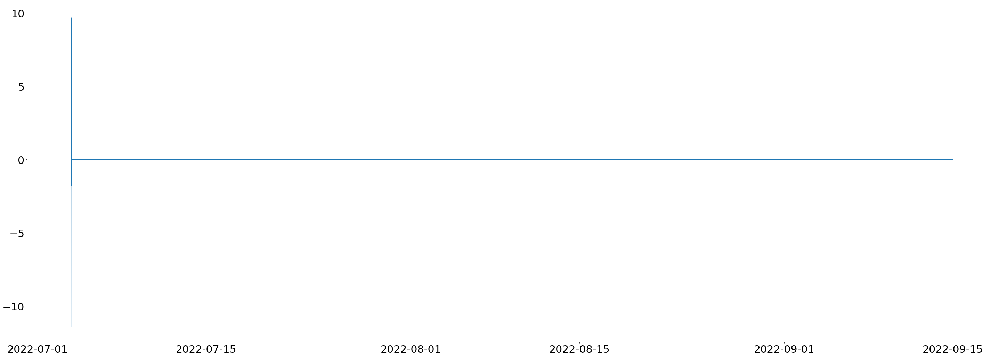

In [130]:
plt.plot(forecast)

In [131]:
RMSE=np.sqrt(mean_squared_error(test["PosDiff"], forecast))
RMSE

30.628299807812613